<center> 

<img src="data/Rossmann.png">

</center>

# <center>  Rossmann Retail - Use Case </center> 

By 2015, Rossmann operates over 1,950 drug stores in Germany with almost 20,000 products per store, and it has about 50 million Stock Keeping Units [(SKUs)](https://www.relexsolutions.com/de/news/rossmann-nutzt-scm-software-von-relex/). Currently, Rossmann store managers look forward to improve the assortment in the shells of stores: The objective is to predict their daily sales for up to six weeks in advance.  

The influence of promotions, competition is known. Also, the effect of events like school and state holidays, seasonality, and locality is known.  
Here we will try to create new indicators to improve the forecast as a trainning exercise.

Goals of this notebook: 
    
- Explore rossmann data set:  the data has been extensively studied in Kaggle, here we just show a few features to get familiarized with the data
- Come up with new takeaways exploring different areas in the rossmann data.
- Define new KPI's:
    - <b>Sales per customer</b>: From the features `sales` and `customers` in the data set we can create a new feature 'sales per customer'. 
    - <b>Method of payment</b>:. If we assume that the number of customers is equal to the number of transactions then we cn use the data in  [ "Payment behaviour in Germany in 2011 An empirical study of the utilisation of cash and cashless payment instruments"](https://www.bundesbank.de/resource/blob/626548/9db72e9451ec46fe5f4969deb2e56181/mL/payment-behaviour-in-germany-in-2011-data.pdf ) to establish the number of transactions with different methods.  Here we use the fraction of transactions made in the 3 most prominent methods  of payment: credit, cash,  gyrocard according   to the study in 2011. 
   
- Perform predictions over sales on selected types of stores using weather features as regressors. 
    
Contents:
- Exploratory Data Analysis
- Time Series
- Forecasting:
    1. Prediction for Global Sales
    2. Focus on Subset of stores of type a
    3. Forecast on subset : stores of type a and open on Sunday
    4. Forecast on Individual Stores

Disclaimer: This is only a training exercise. 

## Importing libraries and loading Rossmann Data

In [1]:
import warnings
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
from pandas import datetime

from datetime import datetime
from datetime import timedelta

import matplotlib.pyplot as plt
import seaborn as sns

#from statsmodels.distributions.empirical_distribution import ECDF
from statsmodels.distributions.empirical_distribution import ECDF
import statsmodels.api as sm

#from statsmodels.tsa.seasonal import seasonal_decompose
#from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

from prophet import Prophet

In [13]:
import plotly.graph_objects as go
import plotly.express as px
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import phik
from statsmodels.tsa.stattools import acf,pacf, adfuller

In [12]:
from plot_methods import *
from metrics import *
from datetime import datetime
from datetime import timedelta
import pickle

In [20]:
# importing train data to learn
train = pd.read_csv("data/train.csv", 
                    parse_dates = True, low_memory = False, index_col = 'Date')

store = pd.read_csv("data/store.csv", 
                    parse_dates = True, low_memory = False)

# Exploratory Data Analysis

    - Kaggle challenge yields an extensive list of EDA discussions and presentations. 
    - Here, you will find a few ideas in accordance to what we want to explore.

### Description of data and null values

<b> sales table</b>

In [5]:
print("In total:")
print("Rows: " ,  train.shape[0])
print("Cols: " , train.shape[1])
train.head(5).append(train.tail(5))

In total:
Rows:  1017209
Cols:  8


,Store,DayOfWeek,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
Date,,,,,,,,
2015-07-31,1,5,5263,555,1,1,0,1
2015-07-31,2,5,6064,625,1,1,0,1
2015-07-31,3,5,8314,821,1,1,0,1
2015-07-31,4,5,13995,1498,1,1,0,1
2015-07-31,5,5,4822,559,1,1,0,1
2013-01-01,1111,2,0,0,0,0,a,1
2013-01-01,1112,2,0,0,0,0,a,1
2013-01-01,1113,2,0,0,0,0,a,1
2013-01-01,1114,2,0,0,0,0,a,1


__Description of columns:__

- `Date`: record of the day of sales for in all different stores 
- `Store`: Identifies a particular store out of 1115 stores.
- `DayOfWeek`: 1: Monday, 2: Tuesday, 3: Wednesday, and so on.
- `Open` : indicator for whether the store was open: 0 = closed, 1 = open
- `Sales`: total sales for a given  store in the given day
- `Customers` : number of customers on a given day.
- `promo`: indicates whether a store is running a promo on that day.
- `StateHoliday`:  indicates a state holiday. Normally all stores, with few exceptions, are closed on state holidays.
- `SchoolHoliday`: ndicates if the (Store, Date) was affected by the closure of public schools.

Some stores report cero sales in days where the store is open:

In [21]:
# opened stores with zero sales
zero_sales = train[(train.Open != 0) & (train.Sales == 0)]

print("Records with open stores and cero sales: " ,  zero_sales.shape[0])
zero_sales.head()

Records with open stores and cero sales:  54


,Store,DayOfWeek,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
Date,,,,,,,,
2015-05-15,971,5,0,0,1,0,0,1
2015-03-26,674,4,0,0,1,0,0,0
2015-02-05,699,4,0,0,1,1,0,0
2014-10-01,708,3,0,0,1,1,0,0
2014-09-22,357,1,0,0,1,0,0,0


In [22]:
print("Time Frame")
min_date, max_date = train.index.min(), train.index.max()
range_date = max_date - min_date
print(min_date, max_date, "   Total of: ", range_date)

Time Frame
2013-01-01 00:00:00 2015-07-31 00:00:00    Total of:  941 days 00:00:00


Get null values:

In [25]:
get_frac_null_values(train)

,column,% Null values
0,Store,0%
1,DayOfWeek,0%
2,Sales,0%
3,Customers,0%
4,Open,0%
5,Promo,0%
6,SchoolHoliday,0%


<b> Store Table </b>

In [8]:
print("Rows: " ,  store.shape[0])
print("Cols: " , store.shape[1])
store.head(5).append(store.tail(5))

Rows:  1115
Cols:  10


,Store,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN
1,2,a,a,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct"
2,3,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3,4,c,c,620.0,9.0,2009.0,0,NaN,NaN,NaN
4,5,a,a,29910.0,4.0,2015.0,0,NaN,NaN,NaN
1110,1111,a,a,1900.0,6.0,2014.0,1,31.0,2013.0,"Jan,Apr,Jul,Oct"
1111,1112,c,c,1880.0,4.0,2006.0,0,NaN,NaN,NaN
1112,1113,a,c,9260.0,NaN,NaN,0,NaN,NaN,NaN
1113,1114,a,c,870.0,NaN,NaN,0,NaN,NaN,NaN
1114,1115,d,c,5350.0,NaN,NaN,1,22.0,2012.0,"Mar,Jun,Sept,Dec"


Get null values in store table:

In [18]:
get_frac_null_values(store)

,column,% Null values
0,Store,0%
1,CompetitionDistance,0%
2,CompetitionOpenSinceMonth,32%
3,CompetitionOpenSinceYear,32%
4,Promo2,0%
5,Promo2SinceWeek,49%
6,Promo2SinceYear,49%


- Only columns related to competition and promo have null values. We will fill them with zeros. 

In [26]:
store.fillna(0, inplace = True)

<b> Merge sales and store datasets</b>

In [27]:
print("Joining train set with an additional store information.")
# by specifying inner join we make sure that only those observations 
# that are present in both train and store sets are merged together
train_store = pd.merge(train, store, how = 'inner', on = 'Store')
print("In total: ")
print("Rows: " ,  train_store.shape[0])
print("Cols: " , train_store.shape[1])
train_store.head(10)
#Edit the design (Display in two rows)

Joining train set with an additional store information.
In total: 
Rows:  1017209
Cols:  17


,Store,DayOfWeek,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,5,5263,555,1,1,0,1,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0
1,1,4,5020,546,1,1,0,1,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0
2,1,3,4782,523,1,1,0,1,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0
3,1,2,5011,560,1,1,0,1,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0
4,1,1,6102,612,1,1,0,1,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0
5,1,7,0,0,0,0,0,0,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0
6,1,6,4364,500,1,0,0,0,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0
7,1,5,3706,459,1,0,0,0,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0
8,1,4,3769,503,1,0,0,0,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0
9,1,3,3464,463,1,0,0,0,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0


<b>Correlation</b>

interval columns not set, guessing: ['DayOfWeek', 'Sales', 'Customers', 'Promo', 'SchoolHoliday']


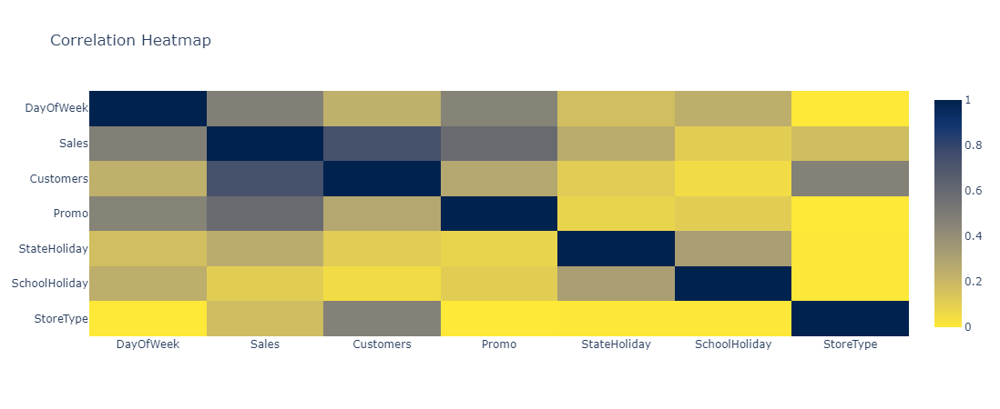

In [21]:
correlation_phik(train_store.dropna(),['Store','Open', 'Promo2', 'Assortment','Promo2SinceWeek', 'Promo2SinceYear', 'PromoInterval',
                                       "CompetitionOpenSinceYear", 'CompetitionDistance', 'CompetitionOpenSinceMonth'], "Correlation Heatmap")  

Observations
- Data set containing sales information has no missing values
- 172817 records of stores closed
- Total ocurrances where a store is open and has 0 sales: 54 records
- Data contains close to 3 years of data

- Sales is correlated with promo and customers
- promo features are correlated among them

## Distribution of Sales

<b> Distribution of daily sales and total sales by individual stores</b>

In [22]:
open_train = train[train['Open']==1]
sales_by_store = train[train['Sales']!=0].groupby('Store').sum()

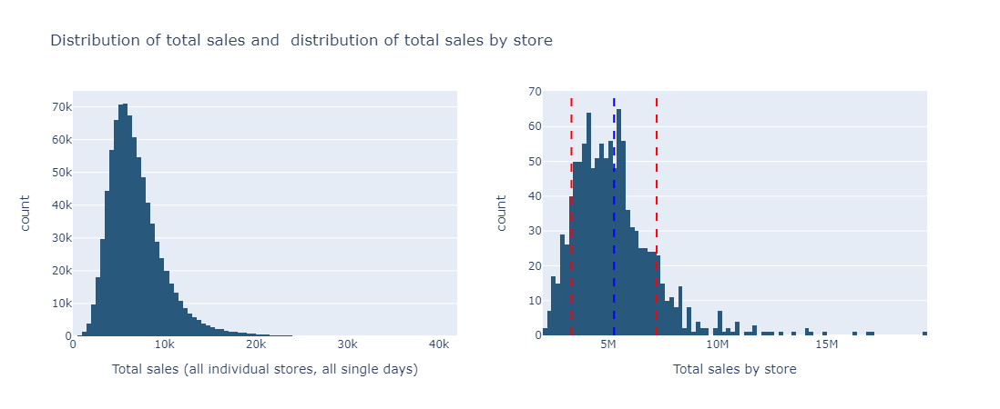

In [23]:
two_histograms(open_train, sales_by_store)

How are sales distributed?

-  Sales per day are mainly concentraded below 15K.
- If we look at thet total sales per store, we see that some stores made more sales as much as 3 or for times more than the average store that is around 5M.
- Sales by store are distributed mostly between 3.2 M and 7.2 M

Note that, in this analysis we don't omitt the days with cero sales if the store was open.

## Define KPI: Sales Per Customer

Define new KPI with the data at hand:

$ sales per customer =    sales / # of customers$

In [24]:
train['SalePerCustomer'] = train['Sales']/train['Customers']
train_store['SalePerCustomer'] = train_store['Sales']/train_store['Customers']

In [25]:
get_frac_null_values(train_store)

,column,% Null values
0,Store,0%
1,DayOfWeek,0%
2,Sales,0%
3,Customers,0%
4,Open,0%
5,Promo,0%
6,SchoolHoliday,0%
7,CompetitionDistance,0%
8,CompetitionOpenSinceMonth,0%
9,CompetitionOpenSinceYear,0%


In [28]:
train_store_mean_by_store = train_store.groupby('Store').mean()
train_store_mean_by_store['log_SalePerCustomer'] = train_store_mean_by_store['SalePerCustomer'].apply(lambda x : np.log(x))

<b>Distribution of average sales per customer</b>

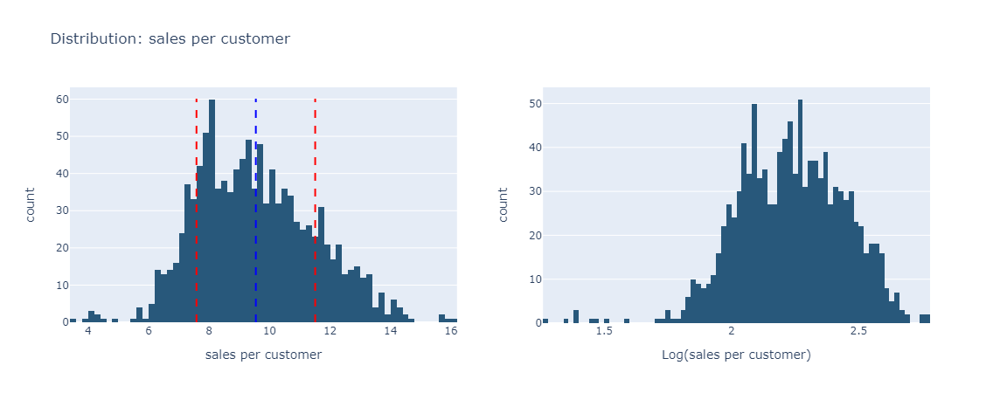

In [29]:
two_histograms_log(train_store_mean_by_store, 'SalePerCustomer', 'log_SalePerCustomer')

On average  customers  (all customers and all stores) spend around $ \$9.5$. 
Sales per customer are concentrated in the interval $ \$7.4$  to $ \$ 11.4$ 

Next we separate the type of store and analize the behavior of the customers

<b> Plot distribution of sales per customer separated by type of store</b>

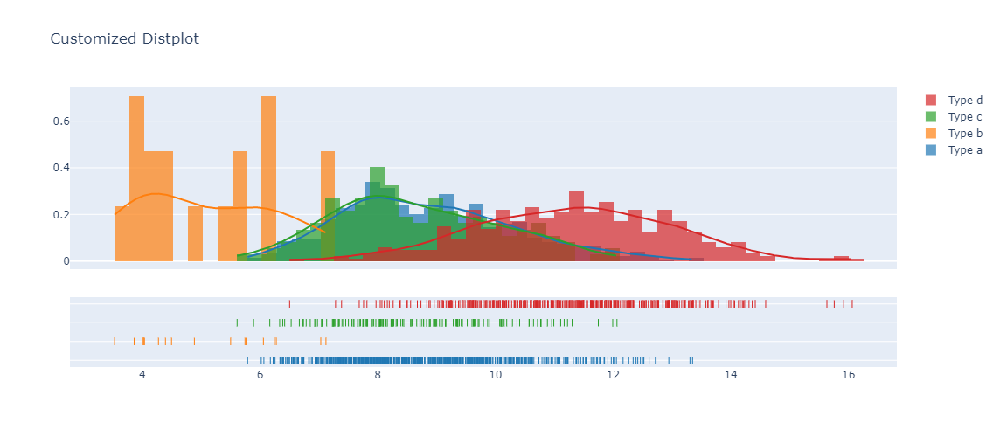

In [43]:
distr_type_store()

- Customers in stores of type c and type a behave similarly. The sales per customer has shifted one unit to the left. 
- The distribution of sales per customes in type d stores has shifted to the right, overall customers spend more money on average on this stores.
- Data from  stores type shows an irregular distribution. More data is needed.

<b>Correlation</b>

In [44]:
train_store.fillna(0, inplace = True)
train.fillna(0, inplace = True)

interval columns not set, guessing: ['DayOfWeek', 'Sales', 'Customers', 'SchoolHoliday', 'SalePerCustomer']


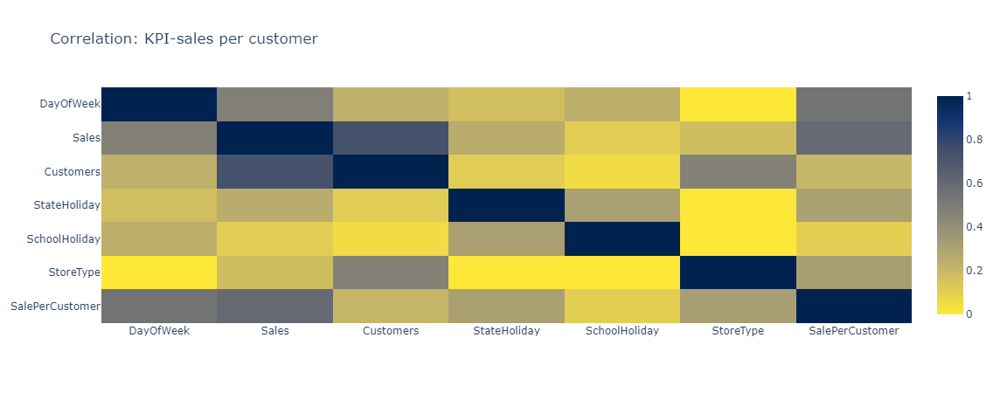

In [45]:
correlation_phik(train_store, ['Open','Promo','Promo2','Promo2SinceWeek','Promo2SinceYear',"PromoInterval", 'Store', 'Assortment', 'CompetitionDistance', 'CompetitionOpenSinceMonth', 'CompetitionOpenSinceYear'], "Correlation: KPI-sales per customer")    

Takeaways:
- Average sales per customer is  $ \$9.55$.
- Min and max are  $ \$3.53$ and  $\$16.06$ respectevly.
- Average Sales increment by the end of the year, in the Christmas season.
- Bad months for sales are january, october and November.
- When it comes to number of customers, this increases also by the end of the year in the Christmas season.
- Sales per customer is lighlty correlated with sales and customers which is consistent with how we obtain the feature.
- Extra info: December is the month where individual customers spend the most on average.

## Define KPI : Method of payment

For the total of customers per day per store, there is a fraction that paid  with card, another fraction paid with cash and a third with gyrocard. According to [Tobias Smith (2011)](https://www.bundesbank.de/resource/blob/626548/9db72e9451ec46fe5f4969deb2e56181/mL/payment-behaviour-in-germany-in-2011-data.pdf) the percentage of transactions in the pharmacy industry is a s follows:

- `cash` :         68.3 %
- `girocard` :    26.6 %
- `redit transfer` :  2.4 %
- `oher` :           2.7 % 

Since the variable 'customers' imply a transaction,
if we want to estimate the sales paid by method X we
can  take the column 'customers' and multiply it by the percentage corresponding to method X. 

We mock the data by creating random data from an interval around the given fraction of transaction method and use the number of customers as numer of total transacctions of the day.
We add the data to the file train_transactions  and load it for further analysis.

This is a sample of the data:


In [46]:
# importing train data to learn
train_transactions = pd.read_csv("data/train_transactions.csv", 
                    parse_dates = True, low_memory = False, index_col = 'Date')

In [47]:
train_transactions.sample(5)

,Store,DayOfWeek,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,cash,giro,transfer,other
Date,,,,,,,,,,,,
2013-09-09,556,1,8380,871,1,1,0,0,566.15,226.46,17.42,60.97
2015-02-04,87,3,5686,723,1,1,0,1,498.87,173.52,28.92,21.69
2015-06-22,1001,1,5017,632,1,0,0,0,455.04,151.68,25.28,0.00
2014-06-04,957,3,9336,948,1,1,0,0,606.72,227.52,37.92,75.84
2015-01-10,501,6,3795,421,1,0,0,0,269.44,117.88,8.42,25.26


Looking for null values:

In [48]:
train_transactions_ = train_transactions.drop(columns = ['Store', 'DayOfWeek', 'Sales', 'Customers', 'Open', 'Promo',  'SchoolHoliday'])
get_frac_null_values(train_transactions_)

,column,% Null values
0,cash,0%
1,giro,0%
2,transfer,0%
3,other,0%


interval columns not set, guessing: ['DayOfWeek', 'Sales', 'Customers', 'cash', 'giro', 'transfer', 'other']


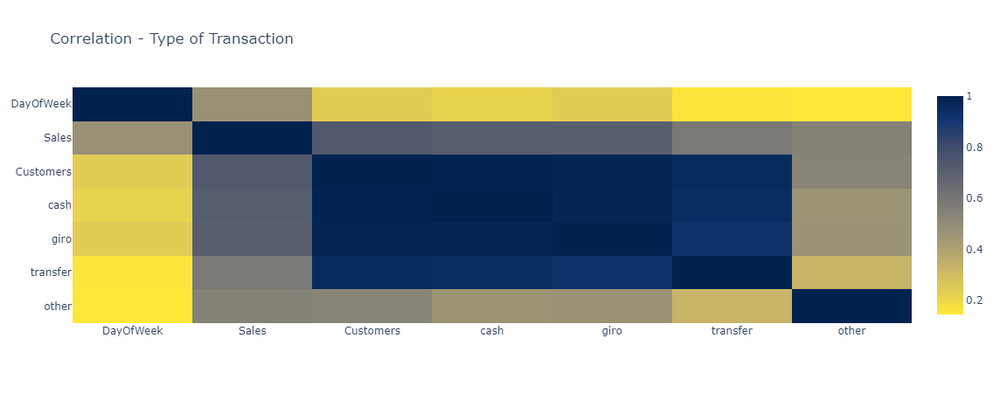

In [49]:
correlation_phik(train_transactions, ['Promo','Open', 'Store', 'StateHoliday', 'SchoolHoliday'], "Correlation - Type of Transaction")  

- All transactions methods are strongly correlated with Customers and since customers is correlated to sales we see also a correlation betweenn the transaction methods and sales. 
- This is because the feature was obtained directly from the number of customers.
- A random variation needs was introduced to simulate a more real scenario.

<b> Average number of transactions by day of the week</b>

In [50]:
payment_method_sum     = train_transactions[(train_transactions['Open']==1)].groupby('DayOfWeek').sum()
payment_method_mean     = train_transactions[(train_transactions['Open']==1)].groupby('DayOfWeek').mean()

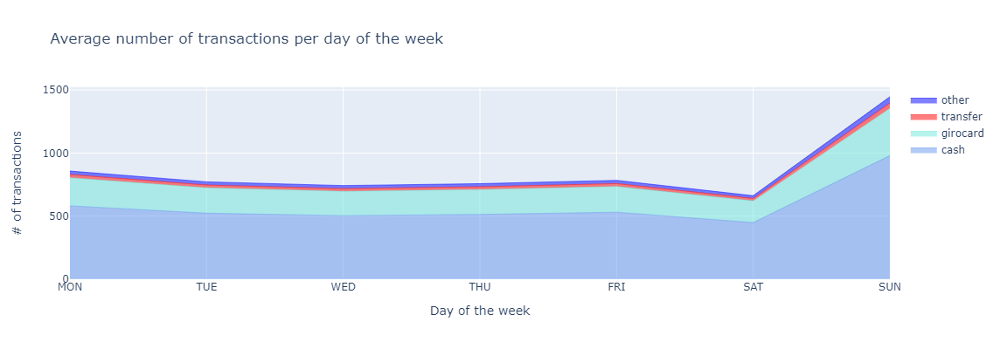

In [51]:
average_number_transactions_dayWeek(payment_method_mean)

<b>Observations</b>

- Cash transactions are predominant trough the whole weeek, followed by giro

- Transfer credit and other have a very small nuber of transactions. Note that credit card is included in 'other'.

- correlation diagram is reduntan in this case since we obtained the new features by scaling the # number of customers


## Weather Data

 From [kb.bullseyelocations.com](https://kb.bullseyelocations.com/article/58-germany-state-codes) we can associate the number of store with the state it is located. Then get the daily weather for that state and merge with the store data.
 
This is a sample of the weather data: 

In [52]:
weather = pd.read_csv('weather_combined.csv')
weather['Date'] = weather['Date']
weather = weather.drop(columns= ['Unnamed: 0'])
weather

,Date,Max_TemperatureC,Mean_TemperatureC,Min_TemperatureC,Max_Humidity,Mean_Humidity,Min_Humidity,Precipitationmm,Events,State
0,2013-01-01,8,3,-2,93,80,51,0.25,Fog-Rain,BW
1,2013-01-02,6,3,-1,93,77,52,0.00,Rain,BW
2,2013-01-03,6,2,-3,93,82,63,2.03,Rain,BW
3,2013-01-04,9,7,4,100,89,81,0.25,Rain,BW
4,2013-01-05,7,6,5,93,83,72,0.76,Rain,BW
...,...,...,...,...,...,...,...,...,...,...
11875,2015-09-13,23,19,15,82,69,45,0.00,Rain,TH
11876,2015-09-14,19,16,12,98,78,54,8.89,Rain-Thunderstorm,TH
11877,2015-09-15,17,13,9,88,64,37,0.00,Normal,TH
11878,2015-09-16,19,16,12,94,70,58,2.03,Rain,TH


Description of columns:
- `Mean_TemperatureC` : mean temperature
- `Mean_Humidity` : mean humidity
- `Precipitationmm` : precipitation in mm
- `Events` : string denoting one of the following weather conditions: Fog-Rain, Rain, Fog, Rain-Snow, Snow, Fog-Snow, Normal, Fog-Rain-Snow, Rain-Thunderstorm, Fog-Rain-Thunderstorm, Thunderstorm, Rain-Snow-Hail, Fog-Thunderstorm, Snow-Hail, Rain-Snow-Thunderstorm, Fog-Rain-Hail-Thunderstorm, Rain-Hail, Rain-Hail-Thunderstorm, Rain-Snow-Hail-Thunderstorm,  Fog-Rain-Hail, Fog-Rain-Snow-Hail, Fog-Snow-Hail
- `State`: Two character abbreviation of the german state where the store is located

In [53]:
print("Time Frame")
weather['Date'] = pd.to_datetime(weather['Date'])
min_date, max_date = weather.Date.min(), weather.Date.max()
range_date = max_date - min_date
print(min_date, max_date, "   Total of: ", range_date)

Time Frame
2013-01-01 00:00:00 2015-09-17 00:00:00    Total of:  989 days 00:00:00


Null Values:

In [54]:
weather_ = weather.drop(columns= ['Max_TemperatureC', 'Min_TemperatureC', 'Max_Humidity', 'Min_Humidity'])
get_frac_null_values(weather_)

,column,% Null values
0,Mean_TemperatureC,0%
1,Mean_Humidity,0%
2,Precipitationmm,0%


<b> Events</b>

In [55]:
weather['Events'].describe()

count     11880
unique       22
top        Rain
freq       4615
Name: Events, dtype: object

In [204]:
#weather['Events'].unique()

- There are 22 types of events, we have to encoded them to use them later as regressors in prophet.
- We will order the events by intensity  and assign an integer, then normalize the array. 

In [56]:
weather['Events'] = weather['Events'].replace({ 'Normal':1,  'Fog':2,'Rain':3, 'Fog-Rain':4, 'Snow':5,
                                                                   'Fog-Snow':6,'Snow-Hail':7, 'Rain-Snow':8,  'Fog-Rain-Snow':9, 'Rain-Snow-Hail':10,
                                                                   'Rain-Hail':11, 'Fog-Rain-Hail':12,'Fog-Snow-Hail':13, 'Fog-Rain-Snow-Hail':14, 'Rain-Thunderstorm':15,
                                                                   'Thunderstorm':16,  'Fog-Thunderstorm':17, 'Fog-Rain-Thunderstorm':18, 'Rain-Hail-Thunderstorm':19,
                                                                   'Rain-Snow-Thunderstorm':20,
                                                                   'Fog-Rain-Hail-Thunderstorm':21,
                                                                   'Rain-Snow-Hail-Thunderstorm':22})

norm = len(weather['Events'].unique())
weather['Events'] = weather['Events'].apply(lambda x : x/norm)

<b>Precipitation</b>

In [57]:
weather['Precipitationmm'].describe()

count    11880.000000
mean         0.852529
std          2.619129
min          0.000000
25%          0.000000
50%          0.000000
75%          0.250000
max         58.930000
Name: Precipitationmm, dtype: float64

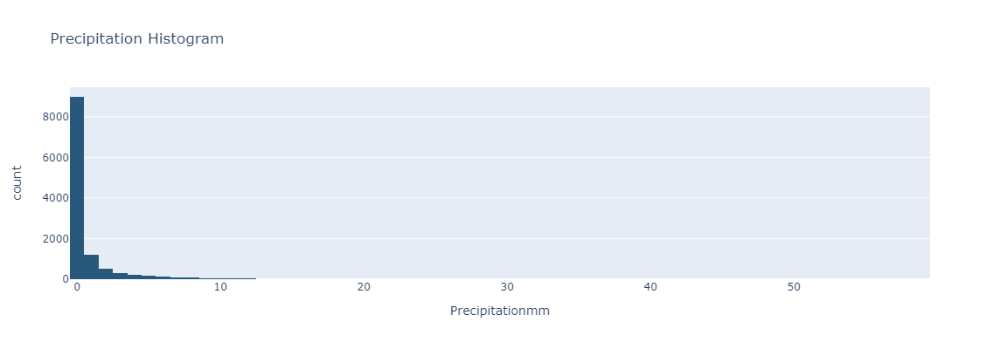

In [59]:
plot_single_distribution_precipitation(weather,'Precipitationmm', "Precipitation Histogram" )

Change precipittion to 0's and  1's.

If precipitation < 0.5 precipitation = 0
else precipitation   = 1

In [60]:
weather['Precipitationmm'] = weather['Precipitationmm'].map(lambda x : 1 if x > 0.5 else 0 )

In [68]:
merged_weather = pd.read_csv('merged_weather.csv')
merged_weather = merged_weather.drop(columns = ['Unnamed: 0', 'Min_TemperatureC',  'Max_Humidity', 'Max_TemperatureC',  'Min_Humidity'])

<b>Correlation</b>

interval columns not set, guessing: ['Sales', 'Customers', 'Promo', 'SchoolHoliday', 'Mean_TemperatureC', 'Mean_Humidity', 'Precipitationmm', 'Events', 'SalePerCustomer']


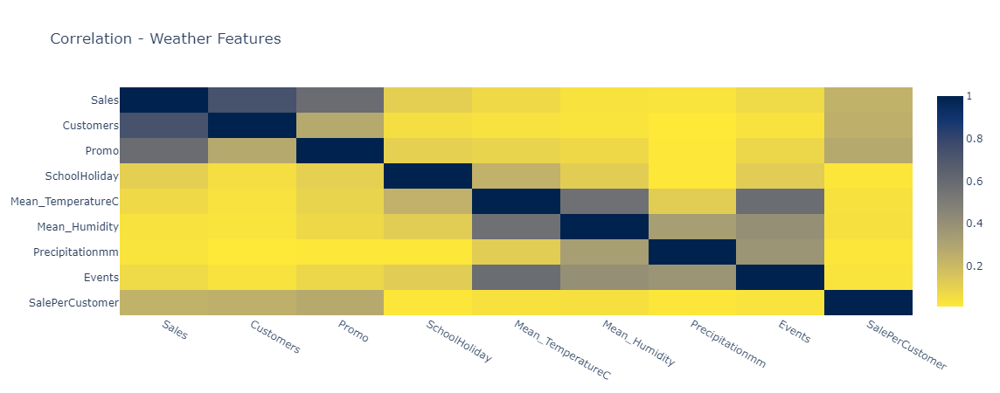

In [70]:
correlation_phik(merged_weather, [ 'Store', 'Open', 'StoreType','Assortment','CompetitionDistance','CompetitionOpenSinceMonth','CompetitionOpenSinceYear','Promo2','Promo2SinceWeek','Promo2SinceYear','PromoInterval','State','DayOfWeek','StateHoliday', 'Date', 'DayOfWeek', 'Promo2OpenInMonths', 'Month', 'month_str', 'IsPromoMonth', 'CompetitionOpenInMonths', 'Year', 'WeekOfYear'], "Correlation - Weather Features")  

<b>Observations</b>
- We obtained weather data that match our table with information of sales and stores.
- weather features seems to have no correlation with sales and Customers.
- As an exercise we will use these features as regressors in the prediction section. We will predict  sales for individual stores and use the weather data in that specific store to test if it has an effect in the behavior of customers. 

# Time series

## Time series: total Sales by month:
Steps:
- Aggregate sales from all stores on a <b>monthly</b> basis. 
- ADF test for stationarity
- Seasonal Plots: Visualize total sales in the 3 years of data available

In [71]:
 sales_m = train.resample('M').agg({'Sales':np.sum, 'Customers': np.sum, 'SalePerCustomer': np.sum})

This is the ADF test:

In [72]:
calculate_adf(sales_m.Sales) 

p-value  0.0069
Time series is a stationary process


<b> Net sales: over 3 years</b>

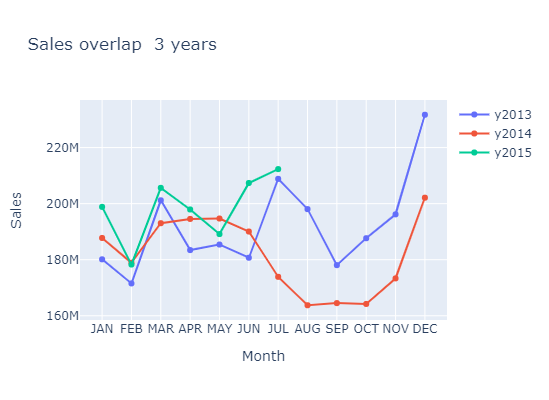

In [73]:
y2013, y2014, y2015 = prepare_monthly_data('sum')
plot_3Years(y2013, y2014, y2015)

- In the two years with complete data, sales increasse on December due to Christmas season
- Sales start low in January in the 3  cases.
- Seems 2013 was a better year for sales in the second part of the year
- 2015 seems to follow the trend of 2013 and 2014 in the first part of the year. By the middle it approaches the trend of the ts of 2013.
- The period of net sales in the year 2014 seems to do wost than 2013. Why is that?
- There is missing data in the second half of the year 2014 wich can be responsible for the notorius decrease in total sales.
- We take the mean instead and with this we remove the effect of the missing data. 

<b> Mean sales: over 3 years </b>

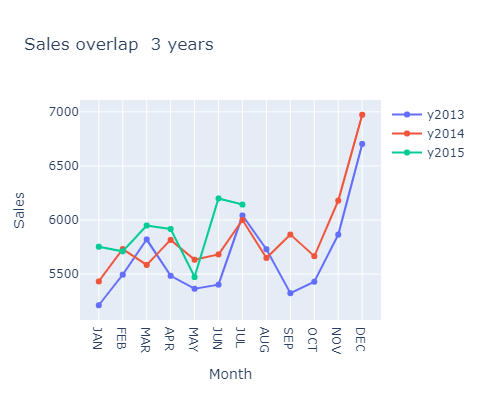

In [74]:
y2013, y2014, y2015 = prepare_monthly_data('mean')
plot_3Years(y2013, y2014, y2015)

## Time series: weekly sales for a single store

Let's study behavior of customers in a particular store:

We can explore individual time series  for <b>store 2</b>
- check trend and seasonality
- Check  for stationarity with Augmented Dicky-Fuller (ADF) test.
- Autocorrelation and Partial Autocorrelation

In [75]:
store2 = train[train['Store']==2]
store2 = store2.sort_index(ascending = True)
store2.fillna(0,inplace = True)
#store2['Date'] = store2.index
#store2['Date'] = pd.to_datetime(store2['Date'])
store2 = store2.groupby('Date').sum()

In [76]:
store2 = store2.Sales.resample('W-Fri').sum()

Calculate ADF

In [77]:
calculate_adf(store2)

p-value  0.0
Time series is a stationary process


In [268]:
type(store2)

pandas.core.series.Series

<b> time series decomposition</b>

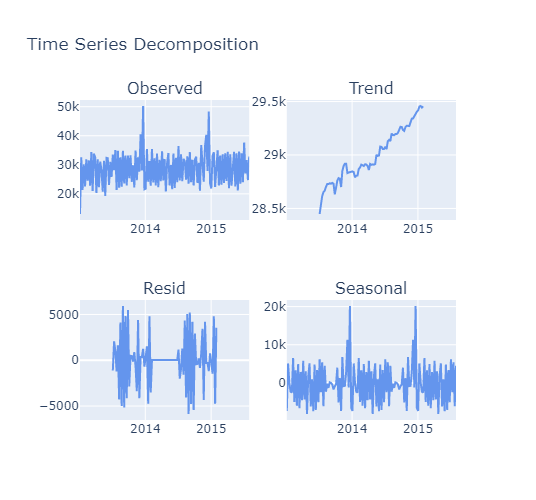

In [86]:
decompose_ts(store2)

Takeaway:

    - having aggregate weekly sales allows to  observe pattern better than having daily sales.
    - The trend on sales for this store is clearly upwards.
    - Seasonality is also marked by  the peaks on Decemeber and stable summers.

<b>Autocorrelation and Partial-Autocorrelation</b>


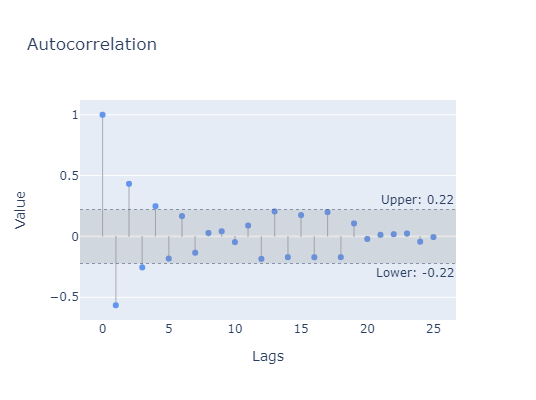

In [87]:
get_acf_plot(store2, nlags = 25)

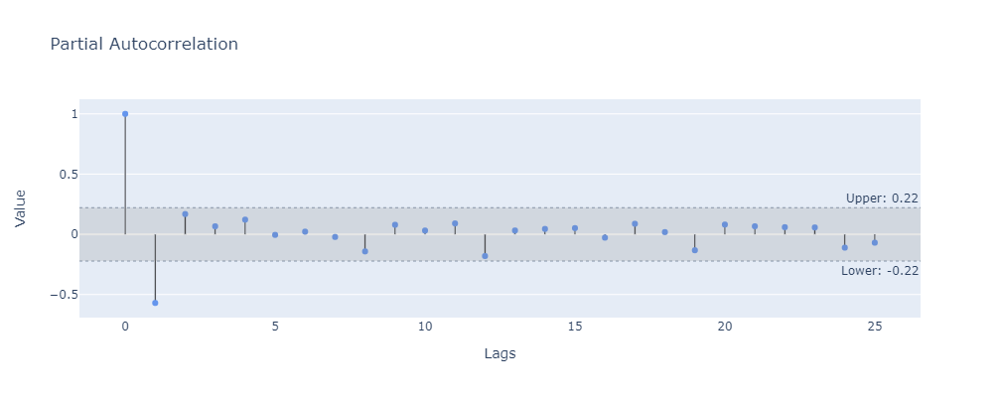

In [88]:
 get_pacf_plot(store2, 25)

Takeawyas:
 - From the ACF the information is relevant up to lag 4 for the present state. 
 - From PACF, Significant correlation up to two lags. Data as old as 1 week have a direct effect on the present state.

## Takeaways:
- Distribution of Net sales is skewed 
- Individual ts of sales shows several 0, possibly on sundays
- Mostly stores are closed on sundays
- Sundays are the days with less customers
- Avg sales also decrease on sundays
- Avg sales per customer decrease on sundays by two units

- The closing sundays for this ts correspond to the winter months and are consistent over the years. 

# Forecasting  

In this section, we will present forecast for sales on a weekly basis using prophet. We then will add weather feaures as regressors. We will use the metric relative root mean squared error (R-RMSE) defined as:
<center>$\text{R-RMSE}=\frac{\sqrt{\frac{\sum{(y-\hat{y})^2}}{N}}}{\sum{y/{N}}}$ </center>  
The larger the difference indicates a larger gap between the predicted and observed values, which means poor regression model fit. In the same way, the smaller RMSE that indicates the better the model.

Subsections:
1. We will start with global sales (all sales, all stores) as a benchmark case. 
2. Then we will present the forcast of sales for a subset of stores (stores of type a)
3. Take sub set that includes stores of type a that open on sundays
4. Take individidual stores and make standard predictions and predictions by adding weather features

In [2]:
#df = pd.read_csv("data/train.csv", 
#                    parse_dates = True, low_memory = False, index_col = 'Date')
df = pd.read_csv("data/train.csv",  
                    low_memory = False)

We will need a dataframe for the holidays. It has to be in the following form:

In [5]:
school_dates = create_school_holidays()

In [6]:
create_school_holidays().head()

,holiday,ds
Date,,
2013-01-04,school_holiday,2013-01-04
2013-01-11,school_holiday,2013-01-11
2013-02-01,school_holiday,2013-02-01
2013-02-08,school_holiday,2013-02-08
2013-02-15,school_holiday,2013-02-15


## 1) Predictions for global sales:  weekly sales (sum) all stores

### 1.1) Global Model (benchmark):
- weekly net sales 
- no regresors
- no holidays
- confidence interval 75%

In [10]:
a,b,c = make_base_benchmark_prediction(df, "Sales", events = False)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Initial log joint probability = -4.41594
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       242.996   1.97907e-06       99.9128           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     108       242.999   4.73382e-06       85.9637   5.568e-08       0.001      176  LS failed, Hessian reset 
     168           243   1.98105e-06       88.4931   1.847e-08       0.001      285  LS failed, Hessian reset 
     189           243   9.46968e-09       90.7186      0.2953      0.2953      309   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Finished calculating Forecast for all stores


In [14]:
_, e = get_rmse_kpi(a,b)
print("R-RMSE: ", e)

R-RMSE:  0.16837320520458185


In [16]:
#plot_individual_store_prediction(a, b, 0, 'Sales', "Base case for benchmarking: add up weekly sales in all stores")

Observations: Results are consistent (with Salvador's)

- RMSE: 0.1684

### 1.2 ) Global Model + events (holidays)

We can include the holidays in the predictions.

- weekly net sales 
- no regressor
- Includes holidays
- confidence interval 75%

In [153]:
#a_,b_,c_ = make_base_benchmark_prediction(df, "Sales", events = True)
# Metrics  0.1677484073215704

In [512]:
_, e = get_rmse_kpi(a_,b_)
print("R-RMSE: ", e)

R-RMSE:  0.1677484073215704


Adding events slighlty improve the prediction by  0.05 %

### 1.3 )  Global Model + regressors + events



We use the weather features as regressors, data was analized in section EDA.

In [104]:
#Now let's do global sales + regressor
print("Weather features:")
weather_features = ['Mean_TemperatureC','Mean_Humidity', 'Precipitationmm', 'Events']
weather_features

Weather features:


['Mean_TemperatureC', 'Mean_Humidity', 'Precipitationmm', 'Events']

In [113]:
#arh, brh, crh, drh  =  make_base_benchmark_prediction_weather_regressor(merged_weather, 'Sales', events = True, w_feature = 'Mean_TemperatureC')

In [114]:
#plot_individual_store_prediction(arh, brh, 0, 'Sales', "Global sales forecast using MeanTemperature as regressor")

In [141]:
#_, e = get_rmse_kpi(arh,brh)
#print("R-RMSE: ", e)

<b>Results: global sales using weahter features as regressors</b>

In [372]:
data_global_regressors = pd.read_csv('metrics_dic_global_w_regressors_holidays.csv')
data_global_regressors = data_global_regressors.drop(columns=['Unnamed: 0', 'r1'])
data_global_regressors = data_global_regressors.rename(columns = {'r2': 'RMSE'})

In [371]:
data_global_regressors

,regressor,RMSE
0,Mean_TemperatureC,0.1799
1,Mean_Humidity,0.1776
2,Precipitationmm,0.1678
3,Events,0.1679


<b>Observations</b>: 
- Adding weather features as regressors does not contribute to a better prediction in this level of dissagregation. 
- The RMSE seems to stay same as the simple calculation wihtout regresor and it gets worst when we add hummidity and temperature.



### 1.4)  Global Model + KPI sales Per customer

We use sales per customer as regressor.

- confidence interval: 75%
- Predicted variable : Sales
- regressor : sales per customer

In [152]:
#a_spc, b_spc, c_spc, d_spc  =  make_base_benchmark_prediction_spc_regressor(train, 'Sales', events = True, reg = 'SalePerCustomer')

In [115]:
#plot_individual_store_prediction(a_spc, b_spc, 0, 'Sales', "Use sales per customer as regressor")

In [161]:
#_, e = get_rmse_kpi(a_spc,b_spc)
#print("R-RMSE: ", e)

In [144]:
#a_spc_, b_spc_, c_spc_, d_spc_  =  make_base_benchmark_prediction_spc_regressor(train, 'Sales', events = False, reg = 'SalePerCustomer')

In [163]:
# _, e = get_rmse_kpi(a_spc_,b_spc_)
# print("R-RMSE: ", e)

### 1.5) Global Model + KPI method of payment cash as regressor 
- confidence interval: 75%
- Predicted variable : weekly sales
- No holidays
- regressor : Number of cash transactions

In [116]:
#a_cash, b_cash, c_cash, d_cash  =  make_base_benchmark_prediction_cash_regressor(train_transactions, 'Sales', events = False, reg = 'cash')

In [137]:
#plot_individual_store_prediction(a_cash, b_cash, 0, 'Sales', "Number of cash transactions as regressor")

In [102]:
_, e = get_rmse_kpi(a_cash,b_cash)
print("R-RMSE: ", e)

R-RMSE:  0.1869824869630607


Includes Holidays

In [136]:
#a_cash, b_cash, c_cash, d_cash  =  make_base_benchmark_prediction_cash_regressor(train_transactions, 'Sales', events = True, reg = 'cash')

In [135]:
_, e = get_rmse_kpi(a_cash,b_cash)
print("R-RMSE: ", e)

R-RMSE:  0.1866038159525266


### Summary of results

**Model** |**simple** |**holidays**
:-----|-----|----- 
**benchmark**|0.1684|0.1677
**temperature regressor**|0.1807| 0.1779
**precipitation regressor**|0.1685| 0.1678
**humidity regressor**|0.1792| 0.1776
**weather events regressor**|0.1686| 0.1679
**sales per customer regressor**|0.1911| 0.1936
**method paymennt regressor**|0.1869| 0.1866

Regressors Takeaways:
- We have used prohet to forecast net weekly sales on the Rossmann data.
- Holidays as event have been added 
- sales per customer and method of payment has been used as regressor, as well as weather features.
- The RMSE has been used as metric
- The best prediction according to the RMSE is the simple benchmark case with holidays (graph is shown below).
- Adding regressors didn't improve significantly the error. In some cases like in the sales per customer regressor the prediction got worst.
- Use of <b>holidays seems to improve the forecast</b> in all cases, therefore we recomend to incluse such feature when prediciting consumer behavior.

Showing only one year of data


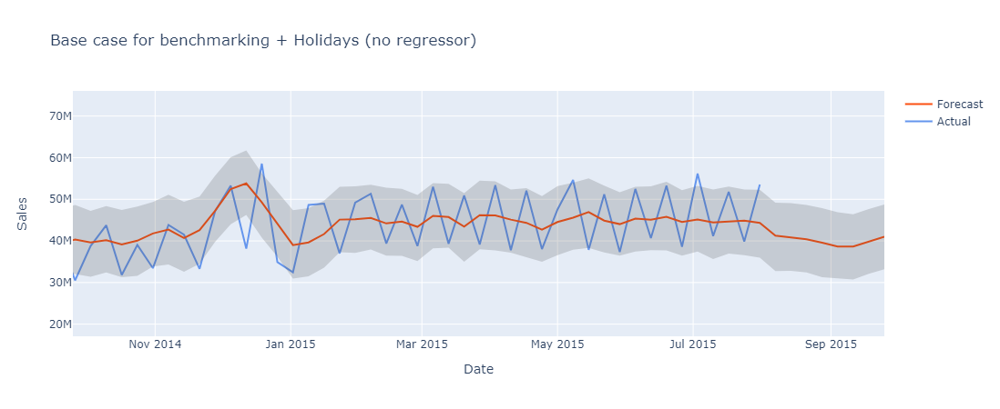

In [155]:
plot_individual_store_prediction(a_, b_, 0, 'Sales', "Base case for benchmarking + Holidays (no regressor)")

<b> General observations</b>
- Sales increase considerably on Christmas season
- January shows a marked drop on sales.
- Sales varies increasing and drecreasing on a regular basis.

<b> Next: </b>
- The forecast follows the trend but misses all the ups and downs shown in the real data.
- In order to give a more accurate sales prediticton we will explore more sophisiticated forecast techniques.


## Predicitions for Type of store

- Explore a level of disagregation by  grouping the data by type of store.
- make sale forecast for each group

Let us understand the data by plotting the distribution of weekly sales in the diferent groups:


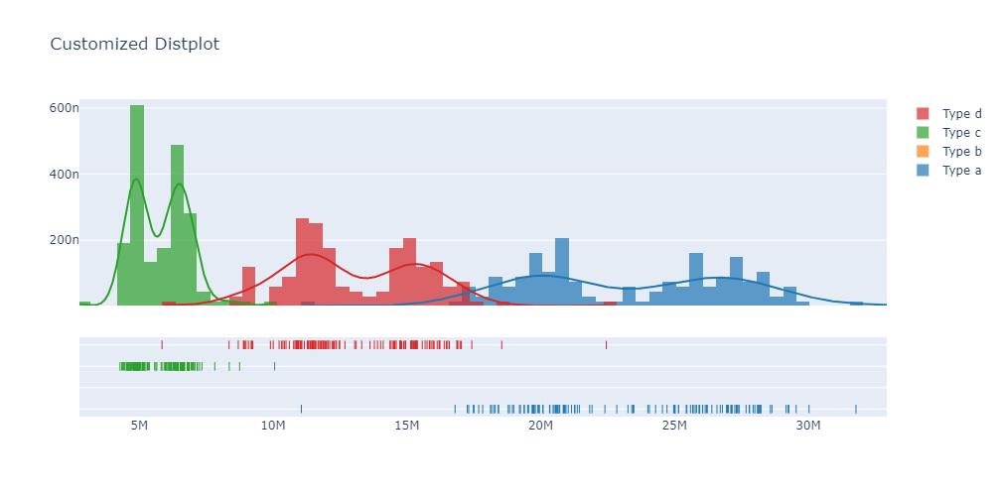

In [226]:
def distr_type_store_net_sals():
    
    data = [store_type_a.Sales.values, store_type_b.Sales.values, store_type_c.Sales.values, store_type_d.Sales.values]
    group_labels = ['Type a', 'Type b', 'Type c', 'Type d']
    
    fig = ff.create_distplot(data, group_labels, bin_size=500000)
    fig.update_layout(title_text='Customized Distplot',
                 height = 500)
    
    return fig

distr_type_store_net_sals()

Observations:
- There is insufficient data in stores of type d
- The rest of the group of stores show a bimodal distribution. 
- Group a has notably higher sales followed by a dn c group.
- Group C has lower sales net sales but a higher count.
- when ploting the different time series we should explect a similar pattern among the series but in a different level.

In [31]:
train = pd.read_csv("data/train.csv", 
                    parse_dates = True, low_memory = False)

store = pd.read_csv("data/store.csv", 
                    parse_dates = True, low_memory = False)


In [32]:
print("Joining train set with an additional store information.")
# by specifying inner join we make sure that only those observations 
# that are present in both train and store sets are merged together
train_store = pd.merge(train, store, how = 'inner', on = 'Store')

Joining train set with an additional store information.


In [169]:
def select_type_store(type_, df):
    stores_type_ = df[df['StoreType']==type_]
    stores_type_['Date'] = pd.to_datetime(stores_type_['Date'])
    stores_type_ = stores_type_.groupby('Date').sum()
    store_sales = stores_type_.resample('W-Fri').agg({'Sales':np.sum})
    return store_sales

In [194]:
store_type_a = select_type_store('a', train_store)
store_type_b = select_type_store('b', train_store)
store_type_c = select_type_store('c', train_store)
store_type_d = select_type_store('d', train_store)

In [264]:
# Uncomment this blocl to calculate predictions
# a_typea,b_typea,c_typea = make_base_all_a_prediction(store_type_a, "Sales", events = False)
# a_typeb,b_typeb,c_typeb = make_base_all_a_prediction(store_type_b, "Sales", events = False)
# a_typec,b_typec,c_typec = make_base_all_a_prediction(store_type_c, "Sales", events = False)
# a_typed,b_typed,c_typed = make_base_all_a_prediction(store_type_d, "Sales", events = False)

In [265]:
# Uncomment this blocl to calculate predictions
#ah_typea,bh_typea,ch_typea = make_base_all_a_prediction(store_type_a, "Sales", events = True)
#ah_typeb,bh_typeb,ch_typeb = make_base_all_a_prediction(store_type_b, "Sales", events = True)
#ah_typec,bh_typec,ch_typec = make_base_all_a_prediction(store_type_c, "Sales", events = True)
#ah_typed,bh_typed,ch_typed = make_base_all_a_prediction(store_type_d, "Sales", events = True)

<b> simple model (no holidays)</b>

In [188]:
print("Type a")
_ , e = get_rmse_kpi(a_typea,b_typea)
print("R-RMSE: ", e)
print("Type b")
_ , e = get_rmse_kpi(a_typeb,b_typeb)
print("R-RMSE: ", e)
print("Type c")
_ , e = get_rmse_kpi(a_typec,b_typec)
print("R-RMSE: ", e)
print("Type d")
_ , e = get_rmse_kpi(a_typed,b_typed)
print("R-RMSE: ", e)

Type a
R-RMSE:  0.16611140078427006
Type b
R-RMSE:  0.08463396373474749
Type c
R-RMSE:  0.165881065741218
Type d
R-RMSE:  0.1856413307514171


### Add school holydays ?

In [259]:
print("Type a")
_ , e = get_rmse_kpi(ah_typea,bh_typea)
print("R-RMSE: ", e)

Type a
R-RMSE:  0.16561411448966926


Showing only one year of data


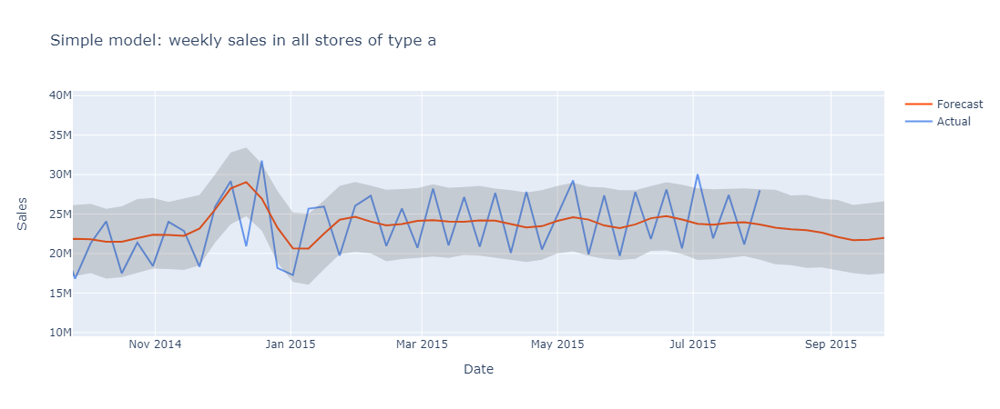

In [173]:
plot_individual_store_prediction(a_a, b_a, 0, 'Sales', "Simple model: weekly sales in all stores of type a")

Showing only one year of data


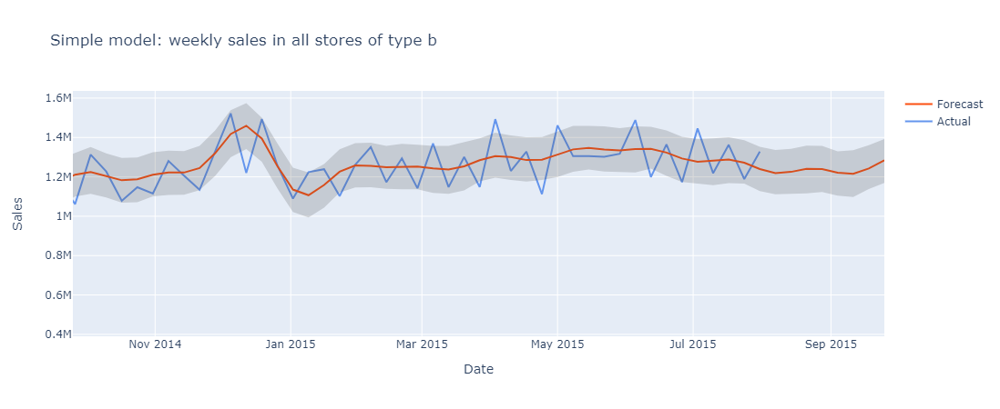

In [176]:
plot_individual_store_prediction(a_typeb,b_typeb, 0, 'Sales', "Simple model: weekly sales in all stores of type b")

In [260]:
print("Type b")
_ , e = get_rmse_kpi(ah_typeb,bh_typeb)
print("R-RMSE: ", e)


Type b
R-RMSE:  0.08209345216313227


Showing only one year of data


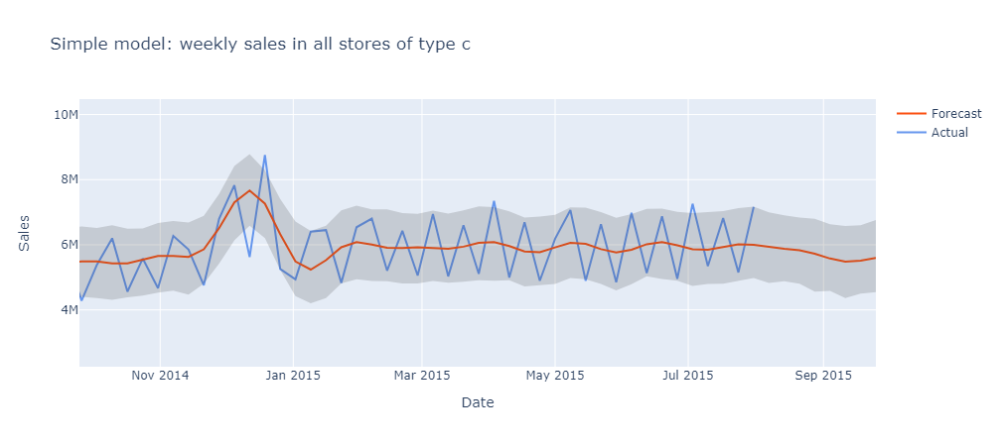

In [183]:
plot_individual_store_prediction(a_typec,b_typec, 0, 'Sales', "Simple model: weekly sales in all stores of type c")

In [261]:
print("Type c")
_ , e = get_rmse_kpi(ah_typec,bh_typec)
print("R-RMSE: ", e)

Type c
R-RMSE:  0.16501544840959198


Showing only one year of data


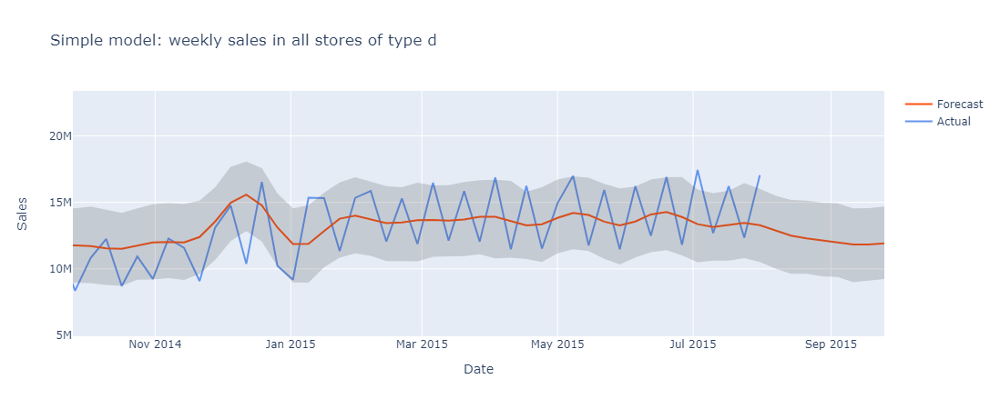

In [182]:
plot_individual_store_prediction(a_typed,b_typed, 0, 'Sales', "Simple model: weekly sales in all stores of type d")

In [262]:
print("Type d")
_ , e = get_rmse_kpi(ah_typed,bh_typed)
print("R-RMSE: ", e)

Type d
R-RMSE:  0.184859354627377


<b>Onservations</b>
- all time series show a similar pattern, a peak in Chistmas season and variations along the trend direction.
- Adding holidays gain a small improvemnt of .1 %

## 2) Focus on Subset of store of type a 
We focus here on a subset of the stores: All stores of <b>type  a</b> (weekly sales)

In [161]:
stores_type_a = train_store[train_store['StoreType']=='a']
stores_type_a['Date'] = pd.to_datetime(stores_type_a['Date'])
stores_type_a = stores_type_a.groupby('Date').sum()
store_a_w = stores_type_a.resample('W-Fri').agg({'Sales':np.sum})

In [185]:
holidays = create_school_holidays()

def make_base_all_a_prediction(df, feature, events):
    """ df: dataframe
        n_store: integer that represents a store
        holidays: df with the holydays
        
        returns:
        forecast: df with the forecast produced by prophet
        sales: ts with sales per customer (modified)
        n_store: store number that has been processed
        
    """

    df['Date'] = df.index
    sales = df.rename(columns = {'Date': 'ds', feature : 'y'})
    sales = sales.fillna(0)
    
    if events == False:
        my_model = Prophet(interval_width = 0.75)
    else:
        my_model = Prophet(interval_width = 0.75, 
                         holidays = holidays)
    my_model.fit(sales)

    # dataframe that extends into future 6 weeks 
    #future_dates = my_model.make_future_dataframe(periods = 6*7)
    
    # dataframe that extends into future 6 weeks 
    #future_dates = my_model.make_future_dataframe(periods = 6)
    future_dates =  pd.DataFrame({'ds': pd.date_range('2013-01-01', '2015-09-25', freq='W-Fri')})

    #print("First week to forecast.")
    #future_dates.tail(7)
    
    forecast = my_model.predict(future_dates)
    
    # preditions for last week
    #forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail(7)
    
    print("Finished calculating Forecast for all stores of type a" )
    return forecast, sales, feature

<b>Forecast: weekly sales in all stores of type a (no holidays)</b>

In [166]:
#a1,b1,c1 = make_base_all_a_prediction(store_a_w, "Sales", events = False)

In [157]:
# plot_individual_store_prediction(a1, b1, 0, 'Sales', "Simple model: weekly sales in all stores of type a")

In [165]:
_ , e = get_rmse_kpi(a1,b1)
print("R-RMSE: ", e)

R-RMSE:  0.16611140078427006


<b>Forecast: weekly sales in all stores of type a (holidays)</b>

In [289]:
#a2,b2,c2 = make_base_all_a_prediction(store_a_w, "Sales", events = True)

In [206]:
_ , e = get_rmse_kpi(a2,b2)
print("R-RMSE: ", e)

R-RMSE:  0.16572211572019896


In [223]:
 #plot_individual_store_prediction(a2, b2, 0, 'Sales', "net sales: added holidays")

Observations:
- around 600 stores are of type a -> Total sales decreases considerable
- Pattern is still clear: 
    - peak on cristmas season 
    - drop in january 
    - and then a flat trend for the rest of the year.
    - Adding holidays improved the prediction in 0.01 %

In [158]:
# ##  all Stores type a : not open sunday

## 3) Forecast subset:  Stores type a & open sunday

Here we decrease the number of stores in the subset, we only include stores of type a that open on sundays.

There are 13 stores that satisfy this condition:

In [228]:
train_store_a = train_store[train_store.StoreType=='a'] # all stores of type a
condition = train_store_a[(train_store_a['DayOfWeek']==7)&(train_store_a['Open']==1)].Store.unique()
print(condition)

[ 122  209  310  433  453  524  530  732  863  877  931 1045 1099]


In [168]:
train_store_a_openSun = train_store[train_store['Store'].isin(condition)]   # stores type a that open on sundays

<b> stores type a & open sunday  : prediction with NO holidays </b>

In [232]:
#a3, b3 , c3 =  make_base_benchmark_prediction_stores_a_open(train_store_a_openSun, 'Sales', events = False)

In [156]:
# plot_individual_store_prediction(a3, b3, 0, 'Sales', "Preditcion sales on stores (a) that open on sundays (add up weekly sales)")

In [231]:
_, e = get_rmse_kpi(a3,b3)
print("R-RMSE: ", e)

R-RMSE:  0.11581557806328492


<b> stores type a & open sunday  : prediction with holidays </b>

In [239]:
#a_hol,b_hol,c_hol =  make_base_benchmark_prediction_stores_a_open(train_store_a_openSun, 'Sales', events = True)

In [237]:
_, e = get_rmse_kpi(a_hol,b_hol)
print("R-RMSE: ", e)

R-RMSE:  0.11202431041442101


Showing only one year of data


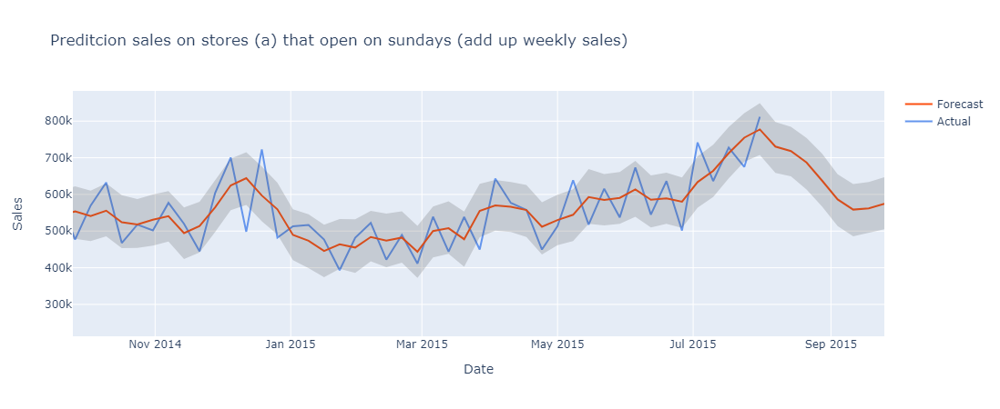

In [497]:
 plot_individual_store_prediction(a_hol, b_hol, 0, 'Sales', "Preditcion sales on stores (a) that open on sundays (add up weekly sales)")

<b>Summary of results of models with and without events</b>

**Model** |**simple** |**holidays**
:-----|-----|----- 
**global**|0.1684|0.1678
**all type a**|0.1660|0.1657
**type a & open sunday**|0.1158| 0.1120

- In all cases the  prediction improved by adding the holidays factor.
- As we go down on the dissagregation level by stores we see a more irregular time series
- Christmas peak  and drop and january are still marked.
- Forecast is more accurate when dissagregating, first by selecting all type a and then selecting the subset of stores that open on sundays


In [235]:
# # steps to preprocess subset of stores in condition set
# train_store_a_openSun['Date']  = pd.to_datetime(train_store_a_openSun['Date'])
# train_store_a_openSun = train_store_a_openSun.set_index('Date')
# train_store_a_openSun = train_store_a_openSun.resample('W-Fri').agg({'Sales':np.sum})
# train_store_a_openSun['Date'] = train_store_a_openSun.index
# sales = train_store_a_openSun.rename(columns = {'Date': 'ds', 'Sales' : 'y'})
# sales = sales.fillna(0)


def make_base_benchmark_prediction_stores_a_open(df, feature, events):
    """ df: dataframe
        n_store: integer that represents a store
        holidays: df with the holydays
        
        returns:
        forecast: df with the forecast produced by prophet
        sales: ts with sales per customer (modified)
        n_store: store number that has been processed
        
    """
    df['Date'] = pd.to_datetime(df['Date'])
    df = df.set_index(df['Date'])
    df = df.resample('W-Fri').agg({'Sales':np.sum})
    df['Date'] = df.index
   
    sales = df.rename(columns = {'Date': 'ds', feature : 'y'})
    sales = sales.fillna(0)
    
    if events == False:
        my_model = Prophet(interval_width = 0.75)
    else:
        my_model = Prophet(interval_width = 0.75, 
                         holidays = school_dates)
    my_model.fit(sales)
    
    # dataframe that extends into future 6 weeks 
    #future_dates = my_model.make_future_dataframe(periods = 6)
    future_dates =  pd.DataFrame({'ds': pd.date_range('2013-01-01', '2015-09-25', freq='W-Fri')})

    forecast = my_model.predict(future_dates)
    
    print("Finished calculating Forecast for all stores in condition" )
    return forecast, sales, feature

## 4) Take individual stores 

Now, we go one level deeper and perform individual forecast for all the single stores that satisfy : type a and open on sundays

- Perform simple forecast
- Perform forecast with events (holidays)

Let us first look at the case of store: 
<b>store 122</b>

In [17]:
def get_holidays_per_store(df_, no_store):
    df_ = df_[df_['Store']==no_store]
    df_['Date'] = pd.to_datetime(df_['Date'])
    df_ = df_.set_index(df_['Date'])

    school_dates = df_.resample('W-Fri').agg({'Sales':np.sum, 'SchoolHoliday': np.sum})
    school_dates['holiday'] = school_dates['SchoolHoliday'].apply(lambda x: 1  if x > 0 else 0  )
    school_dates['ds'] = school_dates.index
    school_dates = school_dates.drop(columns = ['Sales', 'SchoolHoliday']) 
    school_dates = school_dates[school_dates['holiday']==1]
    school_dates['holiday'] = 'school_holiday'
    return school_dates


def make_base_individual_prediction(df, feature, n_store, events):
    """ df: dataframe
        n_store: integer that represents a store
        holidays: df with the holydays
        
        returns:
        forecast: df with the forecast produced by prophet
        sales: ts with sales per customer (modified)
        n_store: store number that has been processed
        
    """  
#     this_df = df[df['Store'] == n_store].loc[:,['Date', feature]]
#     this_df = this_df.sort_index(ascending = False)
#     this_df['Date'] = pd.DatetimeIndex(this_df['Date'])
#     thi_df = this_df.resample('W-Fri').agg({'Sales':np.sum})
#     sales = this_df.rename(columns = {'Date': 'ds', feature : 'y'})
#     sales = sales.fillna(0)
    
    sales_store_N = df[df['Store']==n_store]
    sales_store_N['Date'] = pd.to_datetime(sales_store_N['Date'])
    sales_store_N = sales_store_N.set_index(sales_store_N['Date'])
    sales_store_N_w = sales_store_N.resample('W-Fri').agg({'Sales':np.sum})
    sales_store_N_w['Date'] = sales_store_N_w.index
    sales = sales_store_N_w.rename(columns = {'Date': 'ds', 'Sales' : 'y'})
    sales = sales.fillna(0)
    
    if events == False:
        my_model = Prophet(interval_width = 0.75)
    else:
        hol =  get_holidays_per_store(df, n_store)
        my_model = Prophet(interval_width = 0.75, 
                         holidays = hol)
    my_model.fit(sales)

    # dataframe that extends into future 6 weeks 
    future_dates =  pd.DataFrame({'ds': pd.date_range('2013-01-01', '2015-09-25', freq='W-Fri')})
    
    forecast = my_model.predict(future_dates)

    print("Finished calculating Forecast for store: " + str(n_store))
    return forecast, sales, n_store, feature

In [35]:
#train_store.head()

In [34]:
a122, b122, n, f= make_base_individual_prediction(train_store, 'Sales', 122, events = False)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Initial log joint probability = -5.9943
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       290.705   0.000487294        101.56    0.008293           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     180       291.306   4.65305e-06       99.9949   5.799e-08       0.001      279  LS failed, Hessian reset 
     199       291.306     3.787e-07       82.7162           1           1      304   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217       291.306   3.03604e-09       98.3528     0.02711     0.02711      328   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Finished calculating Forecast for store: 122


<b> forecast: weekly sales for store 122 , no holiday </b>

In [36]:
a122,b122,c122,d122 = make_base_individual_prediction(df, 'Sales' , 122 , events = False)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Initial log joint probability = -5.9943
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       290.705   0.000487294        101.56    0.008293           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     180       291.306   4.65305e-06       99.9949   5.799e-08       0.001      279  LS failed, Hessian reset 
     199       291.306     3.787e-07       82.7162           1           1      304   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217       291.306   3.03604e-09       98.3528     0.02711     0.02711      328   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Finished calculating Forecast for store: 122


In [37]:
_ , e = get_rmse_kpi(a122,b122)
print("R-RMSE: ", e)


R-RMSE:  0.1238766327073519


<b> forecast: weekly sales for store 122 with holiday </b>

In [38]:
a122h,b122h,c122h,d122h = make_base_individual_prediction(train_store, 'Sales' , 122 , events = True)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Initial log joint probability = -5.9943
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       293.547   0.000146297       77.2573           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        293.78   9.18641e-06        86.056           1           1      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     231        293.78   2.31025e-08       92.1997      0.8039      0.8039      296   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Finished calculating Forecast for store: 122


In [39]:
_ , e = get_rmse_kpi(a122h,b122h)
print("R-RMSE: ", e)

R-RMSE:  0.12181711748744271


Showing only one year of data


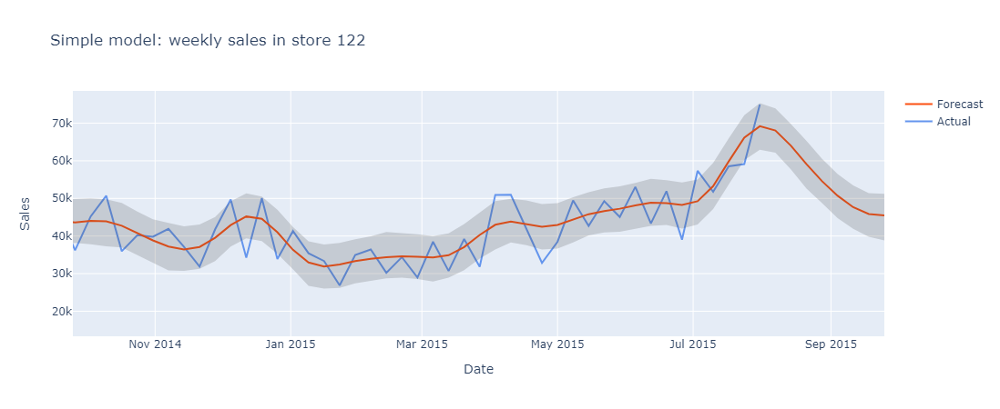

In [50]:
 plot_individual_store_prediction(a122, b122, 122, 'Sales', "Simple model: weekly sales in store 122")

In [258]:
#0.1238766327073519 - 0.12181711748744271

<b>General  Observations - single store: </b>
-  the overall shape of the time series seems more variability compared to the global time series, allthoygh we still see the a small peak in December.
- The trend is upwards with a defined peak on August.
- We also see a decrese on sales on January althoug it is not as marked as in the global sales
- By adding holidays the performance improved by 0.2%

<b>Next</b>
- If we take sales as a measure of demand and if we take this forecast as accurate then we expect a drop on demand in the following weeks  reaching a level of 45 K in the 6th week.
- Perform forecast with Nbeats or similar to give a  more precise prediction.


# STOP

### Results: individual stores forecast with and without holidays

Just use <b>school holidays</b> in individual stores

In [179]:
data_simple = pd.read_csv('metrics_sales_stores_condition.csv')
data_holiday = pd.read_csv('metrics_sales_stores_condition_hol2.csv')
metrics_ind_store = data_simple.merge(data_holiday, on = 'store')
metrics_ind_store = metrics_ind_store.set_index('store')
metrics_ind_store = metrics_ind_store.drop(columns = ['r1_x', 'r1_y','r3','Unnamed: 0_x', 'Unnamed: 0_y'])
metrics_ind_store=  metrics_ind_store.rename(columns = {'r2_x': 'simple', 'r2_y' : 'holidays'})

metrics_ind_store['dif'] = metrics_ind_store['simple'] - metrics_ind_store['holidays'] 


These are the values  of the <b>RMSE</b> of the weekly sales predictions in individual stores.
- `store` is the number of the store being analyzed
- `simple` marks the error of the model without holidays or regresssors
- `holidays` marks the error of the model that takes into account school holidays

In [180]:
metrics_ind_store

,simple,holidays,dif
store,,,
122,0.1239,0.1177,0.0062
209,0.1174,0.1158,0.0016
310,0.1652,0.1638,0.0014
433,0.1433,0.1418,0.0015
453,0.1172,0.1081,0.0091
524,0.1387,0.1378,0.0009
530,0.1308,0.1204,0.0104
732,0.1124,0.1035,0.0089
863,0.1234,0.1217,0.0017


In [397]:
data_temp_hol = pd.read_csv('metrics_single_stores_predictions_w_temp_holidays.csv')
metrics_ind_store_temp = metrics_ind_store.merge(data_temp_hol, on = 'store')
metrics_ind_store_temp = metrics_ind_store_temp.drop(columns = ['Unnamed: 0', 'r1'])
metrics_ind_store_temp = metrics_ind_store_temp.rename(columns = {'r2': 'MeanTemmp'})

In [398]:
data_precip_hol = pd.read_csv('metrics_single_stores_predictions_w_precip_holidays.csv')
metrics_ind_store_temp_precip = metrics_ind_store_temp.merge(data_precip_hol, on = 'store')
metrics_ind_store_temp_precip = metrics_ind_store_temp_precip.drop(columns = ['Unnamed: 0', 'r1'])
metrics_ind_store_temp_precip = metrics_ind_store_temp_precip.rename(columns = {'r2': 'Precipitation'})

In [399]:
data_events_hol = pd.read_csv('metrics_single_stores_predictions_w_events_holidays.csv')
metrics_ind_store_temp_precip_events = metrics_ind_store_temp_precip.merge(data_events_hol, on = 'store')
metrics_ind_store_temp_precip_events = metrics_ind_store_temp_precip_events.drop(columns = ['Unnamed: 0', 'r1'])
metrics_ind_store_temp_precip_events = metrics_ind_store_temp_precip_events.rename(columns = {'r2': 'Events'})

In [400]:
data_humidity_hol = pd.read_csv('metrics_single_stores_predictions_w_humidity_holidays.csv')
metrics_ind_store_temp_precip_events_humidity = metrics_ind_store_temp_precip_events.merge(data_humidity_hol, on = 'store')
metrics_ind_store_temp_precip_events_humidity = metrics_ind_store_temp_precip_events_humidity.drop(columns = ['Unnamed: 0', 'r1'])
metrics_ind_store_temp_precip_events_humidity = metrics_ind_store_temp_precip_events_humidity.rename(columns = {'r2': 'Humidity'})

Observations: 
- By adding the holidays all predictions slightly improve compared to the same simple case with no holidays. 
- It was possible to improve the prediction in some stores compared to the global prediction. However some stores like store 310 shows the same level of error as the global prediction.

<b> Store 1045</b>

In [ ]:
plot_individual_store_prediction(dic_single_stores_predictions_w_temp_holidays[item]['forecast'], dic_single_stores_predictions_w_temp_holidays[item]['sales'], 1045, 'Sales', " store 1045, ")

In [302]:
# predictions_sales_stores_condition = {}
# for item in condition:
#     forecast_, sales_, c, d = make_base_individual_prediction(train_store, 'Sales' , item, events = False)
#     dic_ = {'store': int(item), 'forecast': forecast_ ,'sales': sales_}
#     predictions_sales_stores_condition[str(item)] = dic_

In [ ]:
r1= []
r2 =[]
r3 = []

for item in condition:
    item = str(item)
    b = predictions_sales_stores_condition[item]['sales']['y']
    a = predictions_sales_stores_condition[item]['forecast']['yhat']
    a_temp = a.drop(a.index[a.index >= len(b)])
    # r1 = round(rmse(  b, a_temp.array),4)
    # r2 = round(rmsep( b, a_temp.array),4)
    # r3 = round(rmsev2(b, a_temp.array), 4)
    r1.append( round(rmse(  b, a_temp.array),4))
    r2.append( round(rmsep( b, a_temp.array),4))
    r3.append(round(rmsev2(b, a_temp.array), 4))
    
new_df = pd.DataFrame({'store':condition, 'r1':r1, 'r2':r2, 'r3':r3})
new_df.to_csv('metrics_sales_stores_condition.csv')

In [ ]:
a_file = open("predictions_sales_stores_condition.pkl", "wb")
pickle.dump( predictions_sales_stores_condition, a_file)
a_file.close()

In [181]:
# predictions_sales_stores_condition_hol = {}
# for item in condition:
#     forecast_, sales_, c, d = make_base_individual_prediction(df, 'Sales' , item, events = True)
#     dic_ = {'store': int(item), 'forecast': forecast_ ,'sales': sales_}
#     predictions_sales_stores_condition_hol[str(item)] = dic_

In [198]:
r1= []
r2 =[]

for item in condition:
    item = str(item)
    b = predictions_sales_stores_condition_hol[item]['sales']['y']
    a = predictions_sales_stores_condition_hol[item]['forecast']['yhat']
    a_temp = a.drop(a.index[a.index >= len(b)])
    # r1 = round(rmse(  b, a_temp.array),4)
    # r2 = round(rmsep( b, a_temp.array),4)
    # r3 = round(rmsev2(b, a_temp.array), 4)
    r1.append( round(rmse(  b, a_temp.array),4))
    r2.append( round(rmsep( b, a_temp.array),4))
    
new_df = pd.DataFrame({'store':condition, 'r1':r1, 'r2':r2})
new_df.to_csv('metrics_sales_stores_condition_hol2.csv')

In [97]:
# Open pickle

# a_file = open("predictions_sales_stores_condition_hol.pkl", "rb")
# output = pickle.load(a_file)
# print(output)     ## Do NOT print !!! 
# output['122']['sales']['y']

### Results: individual stores forecast with  regressor

In [121]:
weather_r = pd.read_csv('merged_weather.csv', parse_dates = True, low_memory = False, index_col = 'Date')

In [122]:
weather_r  = weather_r.drop(columns=['Unnamed: 0'])

In [303]:
#aw,bw,cw = make_base_benchmark_prediction_weather(weather_r, "Sales", events = False)

In [330]:
#plot_individual_store_prediction(aw, bw, 0, 'Sales', "Base case for benchmarking: add up weekly sales in all stores")

In [274]:
print("Weather features:")
weather_features = ['Mean_TemperatureC','Mean_Humidity', 'Precipitationmm', 'Events']
weather_features

Weather features:


['Mean_TemperatureC', 'Mean_Humidity', 'Precipitationmm', 'Events']

In [124]:
dic_global_predictions_w_regressors = {}

for feature in weather_features:
        forecast_, sales_,  _ , w_feat = make_base_benchmark_prediction_weather_regressor(weather_r, 'Sales', events = False, w_feature = feature)
        dic_ = {'forecast': forecast_ ,'sales': sales_ , 'weather_feature': feature  }
        dic_global_predictions_w_regressors[str(feature)] = dic_

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Initial log joint probability = -4.41594
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       244.518   2.64813e-06       95.1473    0.003682           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     159       244.524   1.91876e-07       97.3953   1.879e-09       0.001      247  LS failed, Hessian reset 
     169       244.524   4.85667e-09       89.7391      0.2936      0.2936      258   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Finished calculating Forecast for all stores


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Initial log joint probability = -4.41594
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       247.318   0.000367981       103.461      0.4443      0.4443      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     176       247.765    7.8086e-09       86.1681       0.575       0.575      223   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Finished calculating Forecast for all stores


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Initial log joint probability = -4.41594
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       243.333   7.94895e-05       89.8241           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     155       243.341   2.76424e-07       101.799   2.702e-09       0.001      237  LS failed, Hessian reset 
     170       243.341   4.07698e-09       89.8215      0.3545      0.3545      257   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Finished calculating Forecast for all stores


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Initial log joint probability = -4.41594
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       243.319    3.0982e-05       81.3759      0.9667      0.9667      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     137       243.364    6.6959e-05        96.594   6.862e-07       0.001      211  LS failed, Hessian reset 
     199       243.395   6.43401e-08       104.876           1           1      286   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       243.395   9.99641e-09       89.9032       0.288       0.288      292   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Finished calculating Forecast for all stores


In [127]:
r1= []
r2 =[]
r3 = []

#for feature in weather_features:

for item in  weather_features:
    item = str(item)
    b = dic_global_predictions_w_regressors[item]['sales']['y']
    a = dic_global_predictions_w_regressors[item]['forecast']['yhat']
    a_temp = a.drop(a.index[a.index >= len(b)])
    # r1 = round(rmse(  b, a_temp.array),4)
    # r2 = round(rmsep( b, a_temp.array),4)
    # r3 = round(rmsev2(b, a_temp.array), 4)
    r1.append( round(rmse(  b, a_temp.array),4))
    r2.append( round(rmsep( b, a_temp.array),4))
    
new_df = pd.DataFrame({'regressor': weather_features , 'r1':r1, 'r2':r2})
new_df.to_csv('metrics_dic_global_w_regressors.csv')

In [157]:
a_file = open("global_predictions_w_regressors.pkl", "wb")
pickle.dump(dic_global_predictions_w_regressors, a_file)
a_file.close()

In [ ]:
 ## Global ; regressors + holidays

In [373]:
#Last run on  12/21/2021
# dic_global_predictions_w_regressors_holidays = {}

# for feature in weather_features:
#     forecast_, sales_,  _ , w_feat = make_base_benchmark_prediction_weather_regressor(weather_r, 'Sales', events = True, w_feature = feature)
#     dic_ = {'forecast': forecast_ ,'sales': sales_ , 'weather_feature': feature }
#     dic_global_predictions_w_regressors_holidays[str(feature)] = dic_

In [367]:
# r1= []
# r2 =[]
# r3 = []

# #for feature in weather_features:

# for item in  weather_features:
#     item = str(item)
#     b = dic_global_predictions_w_regressors_holidays[item]['sales']['y']
#     a = dic_global_predictions_w_regressors_holidays[item]['forecast']['yhat']
#     a_temp = a.drop(a.index[a.index >= len(b)])
#     # r1 = round(rmse(  b, a_temp.array),4)
#     # r2 = round(rmsep( b, a_temp.array),4)
#     # r3 = round(rmsev2(b, a_temp.array), 4)
#     r1.append( round(rmse(  b, a_temp.array),4))
#     r2.append( round(rmsep( b, a_temp.array),4))
    
# new_df = pd.DataFrame({'regressor': weather_features , 'r1':r1, 'r2':r2})
# new_df.to_csv('metrics_dic_global_w_regressors_holidays.csv')

In [159]:
a_file = open("dic_global_predictions_w_regressors_holidays.pkl", "wb")
pickle.dump(dic_global_predictions_w_regressors_holidays, a_file)
a_file.close()

In [348]:
data_global_regressors = pd.read_csv('metrics_dic_global_w_regressors_holidays.csv')
data_global_regressors = data_global_regressors.drop(columns=['Unnamed: 0', 'r1', 'r3'])
data_global_regressors = data_global_regressors.rename(columns = {'r2': 'RMSE'})

In [ ]:
 plot_individual_store_prediction(a122, b122, 122, 'Sales', "Simple model: weekly sales in store 122")

In [ ]:
dic_global_predictions_w_regressors = {}

for store in condition:
    forecast_, sales_,  _ , w_feat = make_base_benchmark_prediction_weather_regressor(weather_r, 'Sales', events = False, w_feature = feature)
    dic_ = {'forecast': forecast_ ,'sales': sales_ , 'weather_feature': feature  }
    dic_global_predictions_w_regressors[str(feature)] = dic_

In [374]:
def make_base_benchmark_individual_prediction_weather_regressor(df, no_store ,feature , events, w_feature):
    """ df: dataframe
        n_store: integer that represents a store
        holidays: df with the holydays
        
        returns:
        forecast: df with the forecast produced by prophet
        sales: ts with sales per customer (modified)
        n_store: store number that has been processed
        
    """
    
    this_df = df[df['Store']== no_store]
    
    sales_store_N_w = this_df.resample('W-Fri').agg({'Sales':np.sum, w_feature:np.mean })
    #sales_store_N_w['salesPerCustomer'] = sales_store_N_w['Sales']/sales_store_N_w['Customers']
    sales_store_N_w['Date'] = sales_store_N_w.index
    
    sales = sales_store_N_w.rename(columns = {'Date': 'ds', feature : 'y',  w_feature: w_feature})
    sales = sales.fillna(0)
    
    
    if events == False:
        my_model = Prophet(interval_width = 0.75)
    else:
        my_model = Prophet(interval_width = 0.75, 
                         holidays = school_dates)
    
    my_model.add_regressor(w_feature)
    my_model.fit(sales)
   
    future_dates =  pd.DataFrame({'ds': pd.date_range('2013-01-01', '2015-09-25', freq='W-Fri')})
    
    future_dates[w_feature] = sales_store_N_w[w_feature]
    future_dates[w_feature] = future_dates[w_feature].fillna(sales[w_feature].mean())

    forecast = my_model.predict(future_dates)
    
    print("Finished calculating Forecast for all store: ", no_store )
    return forecast, sales, feature, w_feature, no_store

<b> Sample case : Store 122 </b>
- store 122
- no holidays
- weather feature = Mean Temperature

In [378]:
#a_, b_,  _ , w_feat, n_store = make_base_benchmark_individual_prediction_weather_regressor(weather_r, 122,  'Sales', events = False, w_feature = 'Mean_TemperatureC')

In [376]:
_ , e = get_rmse_kpi(a_,b_)
print("R-RMSE: ", e)

R-RMSE:  0.12663770821111006


<b> Sample case : Store 122 </b>
- store 122
- include holidays
- weather feature = Mean Temperature

In [379]:
#a_h, b_h,  _ , w_feat, n_store = make_base_benchmark_individual_prediction_weather_regressor(weather_r, 122,  'Sales', events = True, w_feature = 'Mean_TemperatureC')

In [380]:
_ , e = get_rmse_kpi(a_h,b_h)
print("R-RMSE: ", e)

R-RMSE:  0.11970317236245943


Showing only one year of data


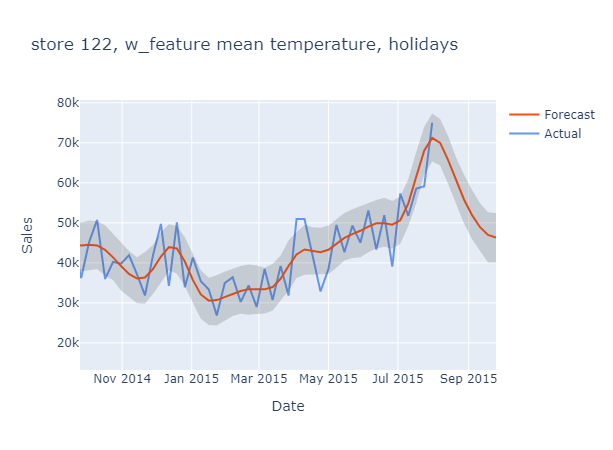

In [482]:
 plot_individual_store_prediction(a_, b_, 122, 'Sales', " store 122, w_feature mean temperature, holidays")

<b>Results</b>

These are the results of the prediction for individual stores using weather as regressor.

The table shows <b> RMSE</b>

In [274]:
metrics_ind_store_temp_precip_events_humidity

,store,simple,holidays,dif,MeanTemmp,Precipitation,Events,Humidity
0,122,0.1239,0.1180,0.0059,0.1244,0.1192,0.1247,0.1341
1,209,0.1174,0.1160,0.0014,0.1185,0.1181,0.1227,0.1278
2,310,0.1652,0.1643,0.0009,0.1706,0.1652,0.1761,0.2096
3,433,0.1433,0.1423,0.0010,0.1427,0.1427,0.1478,0.1481
4,453,0.1172,0.1087,0.0085,0.1129,0.1089,0.1125,0.2418
5,524,0.1387,0.1380,0.0007,0.1401,0.1394,0.1504,0.1433
6,530,0.1308,0.1200,0.0108,0.1618,0.1202,0.1243,0.2273
7,732,0.1124,0.1030,0.0094,0.1073,0.1039,0.1083,0.2431
8,863,0.1234,0.1220,0.0014,0.1255,0.1225,0.1262,0.1255
9,877,0.1344,0.1333,0.0011,0.1384,0.1350,0.1422,0.1418


<b>Observations</b>
- Adding regressors dos not improve the prediction.
- Adding humidity yields a worst prediction according to RMSE

<b>Final Remarks</b>

- Adding the events to the predictions improves the error in all cases
- By makeing prediction on individual stores we lost the marked pattern form the gloabal sales but overall the error decreases.
- Using the weather as a regressor does not improve the prediction, perhaps german population does the shopping despite the weather.
- We don't recommend to use the weather features since it does not improve the forecast and it takes more computing time.

<b> Stop Here </b>

### Calculations for temperature, precipitation, etc

<b>Temperature</b>

In [387]:
# dic_single_stores_predictions_w_temp_holidays = {}

# for store in condition:
# #for feature in weather_features:
#         #a_h,          b_h,  _ , w_feat, no_store = make_base_benchmark_individual_prediction_weather_regressor(weather_r, store,  'Sales', events = True, w_feature = 'Mean_TemperatureC')
#     forecast_, sales_,  _ , w_feat, no_store = make_base_benchmark_individual_prediction_weather_regressor(weather_r, store,  'Sales', events = True, w_feature =  'Mean_TemperatureC')
#     dic_ = {'forecast': forecast_ ,'sales': sales_ , 'weather_feature': feature  }
#     dic_single_stores_predictions_w_temp_holidays[str(store)] = dic_

In [384]:
r1= []
r2 =[]

for item in condition:
    item = str(item)
    b = dic_single_stores_predictions_w_temp_holidays[item]['sales']['y']
    a = dic_single_stores_predictions_w_temp_holidays[item]['forecast']['yhat']
    a_temp = a.drop(a.index[a.index >= len(b)])
    r1.append( round(rmse(  b, a_temp.array),4))
    r2.append( round(rmsep( b, a_temp.array),4))
    
    
new_df = pd.DataFrame({'store':condition, 'r1':r1, 'r2':r2})
new_df.to_csv('metrics_single_stores_predictions_w_temp_holidays.csv')

a_file = open("single_stores_predictions_w_temp_holidays.pkl", "wb")
pickle.dump(dic_single_stores_predictions_w_temp_holidays, a_file)
a_file.close()

Example of forecast for single store:
- store 122
- weather feature : "MeanTemperature"
- inludes holidays
    

Showing only one year of data


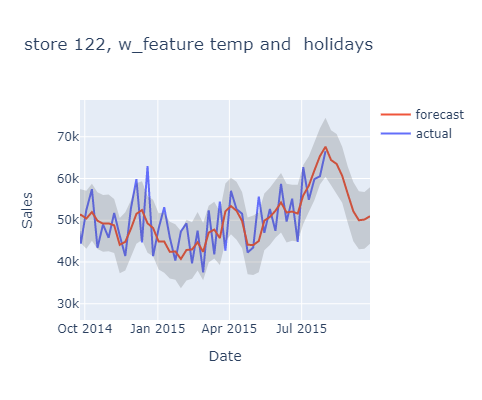

In [385]:
plot_individual_store_prediction(dic_single_stores_predictions_w_temp_holidays[item]['forecast'], dic_single_stores_predictions_w_temp_holidays[item]['sales'], 122, 'Sales', " store 122, w_feature temp and  holidays")

<b>precipitation</b>


In [ ]:
plot_individual_store_prediction(dic_single_stores_predictions_w_temp_holidays[item]['forecast'], dic_single_stores_predictions_w_temp_holidays[item]['sales'], 122, 'Sales', " store 122, w_feature temp and  holidays")

In [396]:
# dic_single_stores_predictions_w_precip_holidays = {}

# for store in condition:
# #for feature in weather_features:
#         #a_h,          b_h,  _ , w_feat, no_store = make_base_benchmark_individual_prediction_weather_regressor(weather_r, store,  'Sales', events = True, w_feature = 'Mean_TemperatureC')
#     forecast_, sales_,  _ , w_feat, no_store = make_base_benchmark_individual_prediction_weather_regressor(weather_r, store,  'Sales', events = True, w_feature =  'Precipitationmm')
#     dic_ = {'forecast': forecast_ ,'sales': sales_ , 'weather_feature': feature  }
#     dic_single_stores_predictions_w_precip_holidays[str(store)] = dic_

In [389]:
r1= []
r2 =[]

for item in condition:
    item = str(item)
    b = dic_single_stores_predictions_w_precip_holidays[item]['sales']['y']
    a = dic_single_stores_predictions_w_precip_holidays[item]['forecast']['yhat']
    a_temp = a.drop(a.index[a.index >= len(b)])
    r1.append( round(rmse(  b, a_temp.array),4))
    r2.append( round(rmsep( b, a_temp.array),4))
    
    
new_df = pd.DataFrame({'store':condition, 'r1':r1, 'r2':r2})
new_df.to_csv('metrics_single_stores_predictions_w_precip_holidays.csv')

a_file = open("single_stores_predictions_w_precip_holidays.pkl", "wb")
pickle.dump(dic_single_stores_predictions_w_precip_holidays, a_file)
a_file.close()

<b> Events <b/>

In [395]:
# dic_single_stores_predictions_w_events_holidays = {}

# for store in condition:
#     forecast_, sales_,  _ , w_feat, no_store = make_base_benchmark_individual_prediction_weather_regressor(weather_r, store,  'Sales', events = True, w_feature =  'Events')
#     dic_ = {'forecast': forecast_ ,'sales': sales_ , 'weather_feature': feature  }
#     dic_single_stores_predictions_w_events_holidays[str(store)] = dic_

In [391]:
r1= []
r2 =[]

for item in condition:
    item = str(item)
    b = dic_single_stores_predictions_w_events_holidays[item]['sales']['y']
    a = dic_single_stores_predictions_w_events_holidays[item]['forecast']['yhat']
    a_temp = a.drop(a.index[a.index >= len(b)])
    r1.append( round(rmse(  b, a_temp.array),4))
    r2.append( round(rmsep( b, a_temp.array),4))
    
    
new_df = pd.DataFrame({'store':condition, 'r1':r1, 'r2':r2})
new_df.to_csv('metrics_single_stores_predictions_w_events_holidays.csv')

a_file = open("single_stores_predictions_w_events_holidays.pkl", "wb")
pickle.dump(dic_single_stores_predictions_w_events_holidays, a_file)
a_file.close()

<b>Mean_Humidity</b>

In [394]:
# #Mean_Humidity
# dic_single_stores_predictions_w_humidity_holidays = {}
# for store in condition:
#     forecast_, sales_,  _ , w_feat, no_store = make_base_benchmark_individual_prediction_weather_regressor(weather_r, store,  'Sales', events = True, w_feature =  'Mean_Humidity')
#     dic_ = {'forecast': forecast_ ,'sales': sales_ , 'weather_feature': feature  }
#     dic_single_stores_predictions_w_humidity_holidays[str(store)] = dic_

In [393]:
# this is next
# Humidity save data
r1= []
r2 =[]

for item in condition:
    item = str(item)
    b = dic_single_stores_predictions_w_humidity_holidays[item]['sales']['y']
    a = dic_single_stores_predictions_w_humidity_holidays[item]['forecast']['yhat']
    a_temp = a.drop(a.index[a.index >= len(b)])
    r1.append( round(rmse(  b, a_temp.array),4))
    r2.append( round(rmsep( b, a_temp.array),4))
    
new_df = pd.DataFrame({'store':condition, 'r1':r1, 'r2':r2})
new_df.to_csv('metrics_single_stores_predictions_w_humidity_holidays.csv')

a_file = open("single_stores_predictions_w_humidity_holidays.pkl", "wb")
pickle.dump(dic_single_stores_predictions_w_humidity_holidays, a_file)
a_file.close()

### Up to here !!!

In [319]:
### Up to here !!!

In [575]:

## Calculate and store RMSE from base forecast (no events)
## for all stores in subset condition
r1= []
r2 =[]
r3 = []

for item in condition:
    item = str(item)
    b = base_predictions_sales[item]['sales']['y']
    a = base_predictions_sales[item]['forecast']['yhat']
    a_temp = a.drop(a.index[a.index >= len(b)])
    # r1 = round(rmse(  b, a_temp.array),4)
    # r2 = round(rmsep( b, a_temp.array),4)
    # r3 = round(rmsev2(b, a_temp.array), 4)
    r1.append( round(rmse(  b, a_temp.array),4))
    r2.append( round(rmsep( b, a_temp.array),4))
    r3.append(round(rmsev2(b, a_temp.array), 4))
    
new_df = pd.DataFrame({'store':condition, 'r1':r1, 'r2':r2, 'r3':r3})
new_df.to_csv('base_model_sales_metric.csv')

In [86]:
def rmsev2(real, y_):
    dif_ = real - y_
    return np.sqrt((dif_**2).mean())/real.mean()

In [577]:
r1= []
r2 =[]
r3 = []

for item in condition:
    item = str(item)
    b = events_predictions_sales[item]['sales']['y']
    a = events_predictions_sales[item]['forecast']['yhat']
    a_temp = a.drop(a.index[a.index >= len(b)])
    # r1 = round(rmse(  b, a_temp.array),4)
    # r2 = round(rmsep( b, a_temp.array),4)
    # r3 = round(rmsev2(b, a_temp.array), 4)
    r1.append( round(rmse(  b, a_temp.array),4))
    r2.append( round(rmsep( b, a_temp.array),4))
    r3.append(round(rmsev2(b, a_temp.array), 4))
    
new_df = pd.DataFrame({'store':condition, 'r1':r1, 'r2':r2, 'r3':r3})
new_df.to_csv('events_model_sales_metric.csv')

In [550]:
## save metrics for foreacst  with events
r1= []
r2 =[]
r3 = []

for item in condition:
    item = str(item)
    b = events_predictions[item]['sales']['y']
    a = events_predictions[item]['forecast']['yhat']
    a_temp = a.drop(a.index[a.index >= len(b)])
    # r1 = round(rmse(  b, a_temp.array),4)
    # r2 = round(rmsep( b, a_temp.array),4)
    # r3 = round(rmsev2(b, a_temp.array), 4)
    r1.append( round(rmse(  b, a_temp.array),4))
    r2.append( round(rmsep( b, a_temp.array),4))
    r3.append(round(rmsev2(b, a_temp.array), 4))
    
new_df = pd.DataFrame({'store':condition, 'r1':r1, 'r2':r2, 'r3':r3})
new_df.to_csv('events_model_metric.csv')

In [566]:
base = pd.read_csv('base_model_metric.csv')
events = pd.read_csv('events_model_metric.csv')
m = base.merge(events, on = 'store')
m['dif'] = m['r3_x'] - m['r3_y']
m

,Unnamed: 0_x,store,r1_x,r2_x,r3_x,Unnamed: 0_y,r1_y,r2_y,r3_y,dif
0,0,122,0.4516,0.0554,0.0554,0,0.4421,0.0542,0.0542,0.0012
1,1,209,0.5186,0.0537,0.0537,1,0.5077,0.0526,0.0526,0.0011
2,2,310,0.7562,0.0647,0.0647,2,0.7448,0.0637,0.0637,0.0010
3,3,433,0.5906,0.0681,0.0681,3,0.5825,0.0671,0.0671,0.0010
4,4,453,0.4515,0.0526,0.0526,4,0.4458,0.0519,0.0519,0.0007
5,5,524,0.5595,0.0597,0.0597,5,0.5434,0.0580,0.0580,0.0017
6,6,530,0.3406,0.0529,0.0529,6,0.3396,0.0527,0.0527,0.0002
7,7,732,0.4252,0.0484,0.0484,7,0.4090,0.0465,0.0465,0.0019
8,8,863,0.4809,0.0574,0.0574,8,0.4735,0.0565,0.0565,0.0009
9,9,877,0.4144,0.0574,0.0574,9,0.4052,0.0561,0.0561,0.0013


In [614]:
def make_individual_prediction(df, feature, n_store, holidays):
    """ df: dataframe
        n_store: integer that represents a store
        holidays: df with the holydays
        
        returns:
        forecast: df with the forecast produced by prophet
        sales: ts with sales per customer (modified)
        n_store: store number that has been processed
        
    """
    
    #this_df = df[df['Store'] == n_store].loc[:,['Date', feature]]
    #this_df = this_df.sort_index(ascending = False)
    #this_df['Date'] = pd.DatetimeIndex(this_df['Date'])
    #sales = this_df.rename(columns = {'Date': 'ds', feature : 'y'})
    #sales = sales.fillna(0)
    
    my_model = Prophet(interval_width = 0.95, 
                         holidays = holidays)
    my_model.fit(sales)

    # dataframe that extends into future 6 weeks 
    #future_dates = my_model.make_future_dataframe(periods = 6*7)
    
    # dataframe that extends into future 6 weeks 
    #future_dates = my_model.make_future_dataframe(periods = 6)
    future_dates =  pd.DataFrame({'ds': pd.date_range('2013-01-01', '2015-09-25', freq='W-Fri')})


    #print("First week to forecast.")
    #future_dates.tail(7)
    
    forecast = my_model.predict(future_dates)

    # preditions for last week
    #forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail(7)
    
    print("Finished calculating Forecast for store: " + str(n_store))
    return forecast, sales, n_store, feature

In [578]:
# df_122 =  train[train['Store'] == 122]
# df_122 =  df_122.sort_index(ascending = False)
# df_122.fillna(0,inplace = True)

# df = train_store
# df_122 = df[df['Store'] == 122].loc[:,['Date', 'SalesPerCustomer']] # Store type A
# df_122 = df_122.sort_index(ascending = False)
# df_122['Date'] = pd.DatetimeIndex(df_122['Date'])
# sales = df_122.rename(columns = {'Date': 'ds', 'SalesPerCustomer': 'y'})
# sales = sales.fillna(0)

# methods and plotting


In [24]:
def get_frac_null_values(df):
    store = df
    fraction_list = []
    names_list = []
    for col in store.columns:
        if (store[col].dtypes =="float64" or store[col].dtypes =="int") and len(store[col])> 0:
            q = store[col].isnull().sum() / len(store)
            q = "{0:.0%}".format(q)
            fraction_list.append(q)
            names_list.append(store[col].name)
    dic_ = {'column': names_list, '% Null values ': fraction_list}
    dict_null = pd.DataFrame(dic_)
    return dict_null

In [11]:
def correlation_phik(df, drop_cols, title_):
    
    df = df.drop(columns = drop_cols)
    correlation_matrix = df.phik_matrix()
    coefficients = correlation_matrix.values
    variables     = correlation_matrix.columns.to_list()
    

    fig = go.Figure(go.Heatmap(z=coefficients,
                               x=variables,
                               y=variables,
                               #type='heatmap',
                               colorscale = px.colors.sequential.Cividis_r
                               #colorscale = "Viridis"
                               #colorscale='Blues'
                               ))
    
    fig.update_layout(yaxis=dict(autorange = 'reversed'),
                      title=title_,
                      height=450)
    return fig

In [12]:
def prepare_monthly_data(how):
    if how == 'mean':
        sales_monthly = train.resample('M').agg({'Sales':np.mean})
    if how == 'sum':
        sales_monthly = train.resample('M').agg({'Sales':np.sum})
       

    one_year = timedelta(days=365)
    
    sales_monthly['Year'] = sales_monthly.index.year
    sales_monthly['Month'] = sales_monthly.index.month
    
    sales_monthly_y2013 = sales_monthly[sales_monthly['Year']==2013]
    sales_monthly_y2014 = sales_monthly[sales_monthly['Year']==2014]
    sales_monthly_y2015 = sales_monthly[sales_monthly['Year']==2015]
    
    shifted_2013_index =  sales_monthly_y2013.index + pd.Timedelta(one_year) + pd.Timedelta(one_year)
    shifted_2013       =  sales_monthly_y2013.set_index(shifted_2013_index)     
    shifted_2014_index =  sales_monthly_y2014.index + pd.Timedelta(one_year)
    shifted_2014       =  sales_monthly_y2014.set_index(shifted_2014_index) 
    
    return shifted_2013, shifted_2014, sales_monthly_y2015

def plot_3Years(df1, df2, df3):
    
    
    important_dates =  ["2015-03-12",  "2015-04-20", "2015-12-25", "2015-09-16"]
    ocasion         =  ['Sal. Birthd', 'some-date','Christmas', 'Independence']
    Months = ['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL','AUG', 'SEP', 'OCT', 'NOV', 'DEC']
    
    hover = "%{y:$,.2f}" 
    fig = go.Figure()
    fig.add_trace(go.Scatter(x = Months,    y = df1['Sales']  , name = "y2013",  hovertemplate="Month: %{x} <br>" + f"{'Sales'}: {hover}" ))
    fig.add_trace(go.Scatter(x = Months,    y = df2['Sales']  , name = "y2014",  hovertemplate="Month: %{x} <br>" + f"{'Sales'}: {hover}" ))
    fig.add_trace(go.Scatter(x = Months,    y = df3['Sales']  , name = "y2015",  hovertemplate="Month: %{x} <br>" + f"{'Sales'}: {hover}" ))
    # fig.add_trace(go.Scatter(x =important_dates,
    #                      y = [0,0,0,0] , 
    #                      marker = {"color":["MidnightBlue", "IndianRed", "MediumPurple","Orange"], "line":{"width":1}, "size":8},
    #                      mode = "markers+text",
    #                      name = 'events',
    #                      #showlegend = False,
    #                      text = ocasion, 
    #                      textposition = "top center"))

    fig.update_layout(xaxis_title = "Month",
                  yaxis_title = 'Sales',
                  title = "Sales overlap  3 years",
                  height = 400,
                  hovermode = "x"   )

    fig.show()

In [41]:
def plot_individual_store_prediction(df_forecast, df_sales, store, feature, title_):
    
    start, end = time_interval(df_forecast)

    fig = go.Figure()
    fig.add_trace(go.Scatter(x = df_sales['ds'],   y = df_sales['y']     , name = "Actual",   hovertemplate="Sales: %{y:$,.2f}" , mode = 'lines', line =dict(color="#6495ed")))
    fig.add_trace(go.Scatter(x = df_forecast.ds,   y = df_forecast.yhat  , name = "Forecast", hovertemplate="Sales: %{y:$,.2f}" , mode = 'lines', line =dict(color="#fb5012")))
    fig.add_trace(go.Scatter(x = df_forecast.ds,   y = df_forecast.yhat_upper , mode = 'lines', line = dict(width = 0), hoverinfo = "skip", showlegend = False, name = "Upper" ))
    fig.add_trace(go.Scatter(x = df_forecast.ds,   y = df_forecast.yhat_lower , mode = 'lines', line = dict(width = 0) , fillcolor= 'rgba(68,68,68, 0.2)', fill = "tonexty", hoverinfo = "skip", showlegend = False, name = "Upper" ))

    fig.update_layout(xaxis_title = "Date",
                      yaxis_title = feature,
                      #title = "Forecast: open on sundays - Store no. " + str(store),
                      height = 450,
                      title = title_,
                      hovermode = "x",
                      xaxis_range = [start, end]   )

    print("Showing only one year of data")

    return fig

# plot methods

In [42]:
def plot_single_ts(df, column, title, x_label, y_label):
  
    fig = px.line(x=df.index, y=df[column])
    fig.update_layout(xaxis_title = x_label,
                  yaxis_title = y_label,
                  title = title)
    return fig

def plot_single_ts_weekly(df, column, title, x_label, y_label):
    df = df.resample('W-Sat').sum()
    fig = px.line(x=df.index, y=df[column])
    fig.update_layout(xaxis_title = x_label,
                  yaxis_title = y_label,
                  title = title)
    return fig

In [43]:

def two_histograms(d1,d2):
    

    
    fig = make_subplots(rows= 1, cols = 2) 
    
    mean = np.mean(d2['Sales'])
    stdev_pluss = np.std(d2['Sales'])
    stdev_minus = np.std(d2['Sales'])*-1
    
    fig.add_trace(go.Histogram(x=d1['Sales'], nbinsx= 100) ,row=1, col=1 )
    
    fig.add_trace(go.Histogram(x=d2['Sales'], nbinsx= 100) ,row=1, col=2 )

    
    fig.add_shape(type = 'line', x0 = mean, x1 = mean, y0 =0, y1=70 , xref='x', yref='y',line = dict(color = 'blue', dash = 'dash'), row = 1, col = 2)
    fig.add_shape(type = "line", x0 = mean + stdev_pluss, x1= mean + stdev_pluss, y0 =0, y1= 70 , xref='x', yref='y', line = dict(color = 'red', dash = 'dash') , row = 1, col = 2)
    fig.add_shape(type = "line", x0 = mean + stdev_minus, x1= mean + stdev_minus, y0 =0, y1= 70 , xref='x', yref='y',  line = dict(color = 'red', dash = 'dash'), row = 1, col = 2)
    
    # Update xaxis properties
    fig.update_xaxes(title_text="Total sales (all individual stores, all single days)", row=1, col=1)
    fig.update_xaxes(title_text="Total sales by store", row=1, col=2)

    # Update yaxis properties
    fig.update_yaxes(title_text="count", row=1, col=1)
    fig.update_yaxes(title_text="count", row=1, col=2)

    fig.update_traces(marker_color='#28587B',
                      name='',
                     showlegend=False,)

    fig.update_layout(title = "Distribution of total sales and  distribution of total sales by store",
                      height = 450,
                      showlegend=False)

    return fig


In [31]:
def two_histograms_log(df, feature1, feature2):
    
    
    fig = make_subplots(rows= 1, cols = 2) 
    
    mean = np.mean(df[feature1])
    stdev_pluss = np.std(df[feature1])
    stdev_minus = np.std(df[feature1])*-1
    
    fig.add_trace(go.Histogram(x=df[feature1],  nbinsx= 100) , row=1, col=1 )
    fig.update_traces(marker_color='#28587B',
                      name='',
                     showlegend=False,)
    fig.add_shape(type = 'line', x0=mean, x1=mean, y0 =0, y1=60 , xref='x', yref='y',line = dict(color = 'blue', dash = 'dash'))
    fig.add_shape(type="line", x0 = mean + stdev_pluss, x1= mean + stdev_pluss, y0 =0, y1= 60 , xref='x', yref='y', line = dict(color = 'red', dash = 'dash'))
    fig.add_shape(type="line", x0 = mean + stdev_minus, x1= mean + stdev_minus, y0 =0, y1= 60 , xref='x', yref='y',  line = dict(color = 'red', dash = 'dash'))
    fig.update_layout(xaxis_title = feature1,
                  yaxis_title = 'count',
                  title = '',
                  height = 450)
    
    fig.add_trace(go.Histogram(x=df[feature2],    nbinsx= 100) ,row=1, col=2 )

    # Update xaxis properties
    fig.update_xaxes(title_text="sales per customer", row=1, col=1)
    fig.update_xaxes(title_text="Log(sales per customer)", row=1, col=2)

    # Update yaxis properties
    fig.update_yaxes(title_text="count", row=1, col=1)
    fig.update_yaxes(title_text="count", row=1, col=2)

    fig.update_traces(marker_color='#28587B',
                      name='',
                     showlegend=False,)

    fig.update_layout(title = "Distribution: sales per customer",
                      height = 450,
                      showlegend=False)

    return fig

In [44]:
def plot_single_distribution(df,feature,title_):
    
    mean = np.mean(df[feature])
    stdev_pluss = np.std(df[feature])
    stdev_minus = np.std(df[feature])*-1
    fig = go.Figure(data=[go.Histogram(x=df[feature],  nbinsx= 100) ])
    fig.update_traces(marker_color='#28587B',
                      name='',
                     showlegend=False,)
    fig.add_shape(type = 'line', x0=mean, x1=mean, y0 =0, y1=3000 , xref='x', yref='y',line = dict(color = 'blue', dash = 'dash'))
    fig.add_shape(type="line", x0 = mean + stdev_pluss, x1= mean + stdev_pluss, y0 =0, y1= 3000 , xref='x', yref='y', line = dict(color = 'red', dash = 'dash'))
    fig.add_shape(type="line", x0 = mean + stdev_minus, x1= mean + stdev_minus, y0 =0, y1= 3000 , xref='x', yref='y',  line = dict(color = 'red', dash = 'dash'))
    fig.update_layout(xaxis_title = feature,
                  yaxis_title = 'count',
                  title = title_,
                  height = 400)
    return fig


def plot_single_distribution_precipitation(df,feature,title_):
    
    fig = go.Figure(data=[go.Histogram(x=df[feature], 
                                   nbinsx= 100) ])
    fig.update_traces(marker_color='#28587B',
                      name='',
                     showlegend=False,)
    fig.update_layout(xaxis_title = feature,
                  yaxis_title = 'count',
                  title = title_,
                  height = 400)
    return fig


In [17]:
def corr_plot(df):
    corr_all = df.drop('Open', axis = 1).corr()

    # Generate a mask for the upper triangle
    mask = np.zeros_like(corr_all, dtype = np.bool)
    mask[np.triu_indices_from(mask)] = True
    
    # Set up the matplotlib figure
    f, ax = plt.subplots(figsize = (11, 9))

    # Draw the heatmap with the mask and correct aspect ratio
    sns.heatmap(corr_all, mask = mask,
            square = True, linewidths = .5, ax = ax, cmap = "BuPu")      
    plt.show()

In [199]:
def distr_type_store():

    
    salesPerCustomer_by_store_a_mean = train_store[(train_store['Open']==1)& (train_store['StoreType']=='a')].groupby('Store').mean()['SalePerCustomer']
    salesPerCustomer_by_store_b_mean = train_store[(train_store['Open']==1)& (train_store['StoreType']=='b')].groupby('Store').mean()['SalePerCustomer']
    salesPerCustomer_by_store_c_mean = train_store[(train_store['Open']==1)& (train_store['StoreType']=='c')].groupby('Store').mean()['SalePerCustomer']
    salesPerCustomer_by_store_d_mean = train_store[(train_store['Open']==1)& (train_store['StoreType']=='d')].groupby('Store').mean()['SalePerCustomer']
    
    
    data = [salesPerCustomer_by_store_a_mean, salesPerCustomer_by_store_b_mean, salesPerCustomer_by_store_c_mean, salesPerCustomer_by_store_d_mean]
    group_labels = ['Type a', 'Type b', 'Type c', 'Type d']
    
    fig = ff.create_distplot(data, group_labels, bin_size=0.25)
    fig.update_layout(title_text='Customized Distplot',
                 height = 500)
    return fig

In [33]:
def  average_number_transactions_dayWeek(payment_method_mean_df):
    #x= list(payment_method_mean.index)
    x = ["MON", "TUE", 'WED', 'THU', 'FRI', 'SAT', 'SUN']

    fig = go.Figure()
    fig.add_trace(go.Scatter(
    x=x, y=list(payment_method_mean_df["cash"]),
    hoverinfo='x+y',
    mode='lines',
    line=dict(width=0.5, color='cornflowerblue'),
    name = 'cash',
    stackgroup='one', # define stack group
    #    groupnorm = 'percent'  # sets the normalization
    ))
    fig.add_trace(go.Scatter(
    x=x, y=list(payment_method_mean_df["giro"]),
    hoverinfo='x+y',
    mode='lines',
    name = 'girocard',
    line=dict(width=0.5, color='rgb(111, 231, 219)'),
    
    stackgroup='one'
    ))
    fig.add_trace(go.Scatter(
    x=x, y=list(payment_method_mean_df["transfer"]),
    hoverinfo='x+y',
    mode='lines',
    name = 'transfer',
    line=dict(width=0.5, color='red'),
#  line=dict(width=0.5, color='rgb(127, 166, 238)'),
    stackgroup='one'
    ))    
    fig.add_trace(go.Scatter(
    x=x, y=list(payment_method_mean_df["other"]),
    hoverinfo='x+y',
    mode='lines',
    name = 'other',
    line=dict(width=0.5, color='blue'),
    stackgroup='one'
    ))    

    #fig.update_layout(yaxis_range=(0, 100))
    fig.update_xaxes(type = 'category')
    fig.update_layout(xaxis_title = "Day of the week",
                  yaxis_title = '# of transactions',
                  title = 'Average number of transactions per day of the week',
                  height = 400)
    return fig


In [34]:
def calculate_adf(series):
    # autolag{“AIC”, “BIC”, “t-stat”, None}
    calculate_adf = adfuller(series, autolag = 'AIC')
    adf = calculate_adf[0]
    pvalue = calculate_adf[1]
    print("p-value ", round(pvalue,4))
    
    if pvalue < 0.05 :
        print("Time series is a stationary process")
    else:
        print("TS not a stationary process")


In [35]:
def line_plot_payment_type_store(df, operation):
    
    payment_method = df
    
    if operation == 'sum':
        fig = go.Figure()
        fig.add_trace(go.Scatter(x = payment_method_sum.index,    y = payment_method_sum['cash'] , name = "cash" ))
        fig.add_trace(go.Scatter(x = payment_method_sum.index,    y = payment_method_sum['girocard'] , name = "giro" ))
        fig.add_trace(go.Scatter(x =payment_method_sum.index,    y =payment_method_sum['creditTransfer'], name = "transfer" ))
        fig.add_trace(go.Scatter(x =payment_method_sum.index,    y = payment_method_sum['other'] , name = "other" ))

        fig.update_layout(xaxis_title = "Day Of Week",
                  yaxis_title = '# of transactions',
                  title = "Sales paid by different methods",
                  height = 400)

        fig.show()
    else:
        fig = go.Figure()
        fig.add_trace(go.Scatter(x = payment_method_mean.index,    y = payment_method_sum['cash'] , name = "cash" ))
        fig.add_trace(go.Scatter(x = payment_method_mean.index,    y = payment_method_sum['girocard'] , name = "giro" ))
        fig.add_trace(go.Scatter(x =payment_method_mean.index,    y =payment_method_sum['creditTransfer'], name = "transfer" ))
        fig.add_trace(go.Scatter(x =payment_method_mean.index,    y = payment_method_sum['other'] , name = "other" ))

        fig.update_layout(xaxis_title = "Day Of Week",
                  yaxis_title = '# of transactions',
                  title = "Sales paid by different methods (Average)",
                  height = 400)

        fig.show()

In [36]:
def plot_sundays_nonsundays(df_sun,df_nosun):

    fig = go.Figure()
    fig.add_trace(go.Scatter(x = df_nosun['Date'],    y = df_nosun['Sales']  , name = "no sundays  #3" ))
    fig.add_trace(go.Scatter(x = df_sun['Date'],    y = df_sun['Sales']  , name = "some sundays #122"))

    fig.update_layout(xaxis_title = "Day Of Week",
                  yaxis_title = 'Sales',
                  title = " Sales in stores type a",
                  height = 400)

    fig.show()
    

In [37]:
def plot_single_ts_store_a(df, store):
    sales = df  
    fig = px.line(x=sales['ds'], y=sales['y'])
    fig.update_layout(xaxis_title = "Date",
                  yaxis_title = 'Sales per customer',
                  title = " Sales per customer  in store" + str(store)+ " (type a)",
                  height = 400)
    fig.show()

In [38]:
def bar_plot(data: pd.DataFrame) -> go.Figure:
    fig = px.bar(data.count().rename('count'))
    fig.update_traces(marker_color='#28587B',
                      hovertemplate = 'Feature: %{x}' + '<br> Non-nulls: %{y:5f}',
                      name='',
                     showlegend=False,)
    fig.update_layout(yaxis_title = 'Counts',
                      xaxis_title='',
                      title='Missing Values - Bar',
                      plot_bgcolor='rgba(0,0,0,0)')
    
    return fig


In [39]:
def get_acf_plot(data: pd.DataFrame, nlags: int=15) -> go.Figure:
    """ 
    Given a dataframe with datetime index and response variable it plots the coefficients of the autocorrelation function. The number of nlags to plot can be submitted.
    
    :param data: A pandas dataframe with the information in time series like fashion.
    :param nlags: An integer, the number of lags to compute the coefficients for the ACF.
    return: A figure graph object with the autocorrelation coefficients for the time series.
    
    """
    # Create the values for the plots
    n = len(data)
    lower = -2.58/np.sqrt(n)
    upper = 2.58/np.sqrt(n)
    y = acf(data, nlags=nlags)
    x = np.arange(len(y))
    x,y = _create_stem_data(x=x, y=y)

    # Crate the figure object
    fig = go.Figure()

    fig.add_hline(y=upper, line_width=0.5,
                  annotation_text=f"Upper: {np.round(upper, 2)}", 
                  annotation_position="top right", 
                  line_dash="dot")

    fig.add_hline(y=lower, line_width=0.5,
                  annotation_text=f"Lower: {np.round(lower, 2)}", 
                  annotation_position="bottom right", 
                  line_dash="dot")

    fig.add_hrect(y0=lower, y1=upper, 
                  line_width=0, fillcolor="gray", 
                  opacity=0.2)

    fig.add_trace(go.Bar(x=x[1::3], y=y[1::3],
                         marker_color='black',
                         name='', hoverinfo='skip',
                         width=[0.05]*len(x[1::3]))
                 ), 

    fig.add_trace(go.Scatter(x=x[1::3], y=y[1::3],
                             mode='markers', name='ACF',
                             hovertemplate= "Lag: %{x} <br>" + "Coefficient: %{y}",
                             marker_color='cornflowerblue'))

    fig.update_layout(title='Autocorrelation',
                      showlegend=False, height=400,
                      xaxis_title='Lags',
                      yaxis_title='Value')

    return fig

In [40]:
# ACF and PACF
def _create_stem_data(x: np.array, y: np.array, baseline: float = 0):
    """
    makes y data passing 0 before inbetween actual value to create data for a stem plot
    x,y are 3 times the original length
    """
    x=np.repeat(x,3)
    y=np.repeat(y,3)
    y[::3]=y[2::3]=baseline
    
    return x,y

In [41]:
def get_pacf_plot(data: pd.DataFrame, nlags: int=15) -> go.Figure:
    """ 
    Given a dataframe with datetime index and response variable it plots the coefficients of the partial autocorrelation function. The number of nlags to plot can be submitted.
    
    :param data: A pandas dataframe with the information in time series like fashion.
    :param nlags: An integer, the number of lags to compute the coefficients for the PACF.
    return: A figure graph object with the partial autocorrelation coefficients for the time series.
    
    """
    
    # Create the values for the plots
    n = len(data)
    lower = -2.58/np.sqrt(n)
    upper = 2.58/np.sqrt(n)
    y = pacf(data, nlags=nlags)
    x = np.arange(len(y))
    x,y = _create_stem_data(x=x, y=y)

    # Crate the figure object
    fig = go.Figure()

    fig.add_hline(y=upper,line_width=0.5,               
                  annotation_text=f"Upper: {np.round(upper, 2)}", 
                  annotation_position="top right", 
                  line_dash="dot")

    fig.add_hline(y=lower,line_width=0.5,
                  annotation_text=f"Lower: {np.round(lower, 2)}", 
                  annotation_position="bottom right", 
                  line_dash="dot")

    fig.add_hrect(y0=lower, y1=upper, 
                  line_width=0, fillcolor="gray", 
                  opacity=0.2)

    fig.add_trace(go.Bar(x=x[1::3], y=y[1::3],
                         marker_color='black',
                         name='', hoverinfo='skip',
                         width=[0.05]*len(x[1::3]))
                 ), 

    fig.add_trace(go.Scatter(x=x[1::3], y=y[1::3],
                             mode='markers', name='PACF',
                             hovertemplate= "Lag: %{x} <br>" + "Coefficient: %{y}",
                             marker_color='cornflowerblue'))

    fig.update_layout(title='Partial Autocorrelation',
                      showlegend=False, height=400,
                      xaxis_title='Lags',
                      yaxis_title='Value')

    return fig

In [42]:
def plot_bar_salePerCustomer(d1):
    fig = make_subplots(rows= 2, cols = 1) 
    
    fig.add_trace(go.Bar( x=d1.index, y=d1["Customers"]) ,row=1, col=1 )

    fig.add_trace(go.Bar( x=d1.index, y=d1["SalePerCustomer"]) ,row=2, col=1 )

    # Update xaxis properties
    #fig.update_xaxes(title_text="Total sales (all individual stores, all single days)", row=1, col=1)
    fig.update_xaxes(title_text="Month", row=2, col=1)

    # Update yaxis properties
    fig.update_yaxes(title_text="Customers", row=1, col=1)
    fig.update_yaxes(title_text="Sales per Customers", row=2, col=1)
    
    fig.update_layout(title = "Average Monthly behaviour",
                      height = 600,
                      showlegend=False)

    return fig


# Prediction methods

In [45]:
def time_interval(some_df):
    one_year = timedelta(days=365)
    last = len(some_df)

    last = some_df.ds.values[last-1]
    last = pd.to_datetime(last)

    start = last - one_year 
    
    return start, last

In [46]:

def decompose_ts(data):

    decomposition = sm.tsa.seasonal_decompose(data)
    
    fig = make_subplots(rows=2, cols=2, subplot_titles=("Observed", "Trend", "Resid", "Seasonal"))
    # Observed or Actual values
    fig.add_trace(go.Scatter(x=decomposition.observed.index, 
                             y=decomposition.observed.values, 
                             marker_color='cornflowerblue',
                             hovertemplate="Date: %{x} <br>" + "Net Sales: $ %{y}"), row=1, col=1)
    # Trend decomposition
    fig.add_trace(go.Scatter(x=decomposition.trend.index, 
                             y=decomposition.trend.values,
                             marker_color='cornflowerblue',
                             hovertemplate="Date: %{x} <br>" + "Net Sales: $ %{y}"), row=1, col=2)
    # Residuals
    fig.add_trace(go.Scatter(x=decomposition.resid.index, 
                             y=decomposition.resid.values, 
                             marker_color='cornflowerblue',
                             hovertemplate="Date: %{x} <br>" + "Net Sales: $ %{y}"), row=2, col=1)
    # Seasonal decomposition
    fig.add_trace(go.Scatter(x=decomposition.seasonal.index, 
                             y=decomposition.seasonal.values, 
                             marker_color='cornflowerblue',
                             hovertemplate="Date: %{x} <br>" + "Net Sales: $ %{y}"), row=2, col=2)
    fig.update_layout(height=500, 
                      autosize=True,
                      title_text="Time Series Decomposition",
                      showlegend=False)
    return fig


In [47]:
def get_rmse_kpi(forecast, reference):
    
    a_temp = forecast.drop(forecast.index[forecast.index >= len(reference)])
    r1 = rmse(reference['y'].array, a_temp['yhat'].array)
    r2 = rmsep(reference['y'].array, a_temp['yhat'].array)
    return r1, r2

In [48]:
#try change confidence interval 0.95
#plot global sales - can include events - no regresssor

# create holidays dataframe
def create_school_holidays():
    df = pd.read_csv("data/train.csv", 
                    parse_dates = True, low_memory = False)
    df['Date'] = pd.to_datetime(df['Date'])
    df = df.set_index(df['Date'])

    school_dates = df.resample('W-Fri').agg({'Sales':np.sum, 'SchoolHoliday': np.sum})

    school_dates['holiday'] = school_dates['SchoolHoliday'].apply(lambda x: 1  if x > 0 else 0  )
    school_dates['ds'] = school_dates.index
    school_dates = school_dates.drop(columns = ['Sales', 'SchoolHoliday']) 
    school_dates = school_dates[school_dates['holiday']==1]
    school_dates['holiday'] = 'school_holiday'
    return school_dates

def create_state_dates():

    df = pd.read_csv("data/train.csv", 
                    parse_dates = True, low_memory = False)
    df['Date'] = pd.to_datetime(df['Date'])
    df = df.set_index(df['Date'])

    state_dates = df
    state_dates['holiday'] = state_dates['StateHoliday'].apply( lambda x : 0 if x == '0' else 1)
    state_dates['ds'] = state_dates.index

    state_dates = state_dates.drop(columns = ['Sales', 'SchoolHoliday', 'Customers', 'DayOfWeek', 'Store', 'Open', 'Promo', 'Date']) 
    state_dates = state_dates.resample('W-Fri').agg({'holiday': np.sum})
    state_dates = state_dates[state_dates['holiday']>0]
    state_dates['ds'] = state_dates.index
    #state_dates = df[(df.StateHoliday == 'a') | (df.StateHoliday == 'b') & (df.StateHoliday == 'c')].loc[:, 'Date'].values
    state_dates['holiday'] = 'StateHoliday'
    return state_dates


def make_base_benchmark_prediction(df, feature, events):
    """ df: dataframe
        events: df with the holydays
        
        returns:
        forecast: df with the forecast produced by prophet
        sales: ts with sales  (modified)
        n_store: store number that has been processed
        
    """
    df['Date'] = pd.to_datetime(df['Date'])
    df = df.set_index(df['Date'])
    
    sales_store_N_w = df.resample('W-Fri').agg({'Sales':np.sum})
    #sales_store_N_w['salesPerCustomer'] = sales_store_N_w['Sales']/sales_store_N_w['Customers']
    sales_store_N_w['Date'] = sales_store_N_w.index
    sales = sales_store_N_w.rename(columns = {'Date': 'ds', feature : 'y'})
    sales = sales.fillna(0)
    
    if events == False:
        my_model = Prophet(interval_width = 0.75)
    else:
        my_model = Prophet(interval_width = 0.75, 
                         holidays = school_dates)
    my_model.fit(sales)
    
    #future_dates = my_model.make_future_dataframe(periods = 6)
    future_dates =  pd.DataFrame({'ds': pd.date_range('2013-01-01', '2015-09-25', freq='W-Fri')})

    forecast = my_model.predict(future_dates)
    
    print("Finished calculating Forecast for all stores" )
    return forecast, sales, feature

In [123]:
def make_base_benchmark_prediction_weather_regressor(df, feature, events, w_feature):
    """ df: dataframe

        
        returns:
        forecast: df with the forecast produced by prophet
        sales: ts with sales per customer (modified)
        
    """

    # df['Date'] = pd.DatetimeIndex( df['Date'])
    # df = df.set_index('Date')
    sales_store_N_w = df.resample('W-Fri').agg({'Sales':np.sum, w_feature:np.sum })
    #sales_store_N_w['salesPerCustomer'] = sales_store_N_w['Sales']/sales_store_N_w['Customers']
    sales_store_N_w['Date'] = sales_store_N_w.index
    sales = sales_store_N_w.rename(columns = {'Date': 'ds', feature : 'y',  w_feature: w_feature})
    sales = sales.fillna(0)
    
    if events == False:
        my_model = Prophet(interval_width = 0.75)
    else:
        my_model = Prophet(interval_width = 0.75, 
                         holidays = school_dates)
    
    my_model.add_regressor(w_feature)    
    my_model.fit(sales)

    future_dates =  pd.DataFrame({'ds': pd.date_range('2013-01-01', '2015-09-25', freq='W-Fri')})
    
    future_dates[w_feature] = sales_store_N_w[w_feature]
    future_dates[w_feature] = future_dates[w_feature].fillna(sales[w_feature].mean())

    forecast = my_model.predict(future_dates)
    
    print("Finished calculating Forecast for all stores" )
    return forecast, sales, feature, w_feature


In [83]:
# use train data set to predict sales using sales per customer as regressor
# future values of sales per customer are mocked by the mean of sales per customer history
def make_base_benchmark_prediction_spc_regressor(df, feature, events, reg):
    """ df: dataframe
        feature: variable to be predicted
        events: true or false
        reg: regressor
        
        returns:
        forecast: df with the forecast produced by prophet
        sales: ts with sales per customer (modified)
        feature:
        reg:
        
    """
    
    #df = df.set_index('Date')
    
    sales_store_N_w = df.resample('W-Fri').agg({'Sales':np.sum, reg:np.sum })
    #sales_store_N_w['salesPerCustomer'] = sales_store_N_w['Sales']/sales_store_N_w['Customers']
    sales_store_N_w['Date'] = sales_store_N_w.index
    sales = sales_store_N_w.rename(columns = {'Date': 'ds', feature : 'y',  reg: reg})
    sales = sales.fillna(0)
    
    if events == False:
        my_model = Prophet(interval_width = 0.75)
    else:
        my_model = Prophet(interval_width = 0.75, 
                           holidays = school_dates)
        
    my_model.add_regressor(reg)    
    my_model.fit(sales)

    future_dates =  pd.DataFrame({'ds': pd.date_range('2013-01-01', '2015-09-25', freq='W-Fri')})
    future_dates[reg] = sales_store_N_w[reg]
    future_dates[reg] = future_dates[reg].fillna(sales[reg].mean())

    
    forecast = my_model.predict(future_dates)
    
    print("Finished calculating Forecast for all stores" )
    return forecast, sales, feature, reg

In [84]:
def make_base_benchmark_prediction_cash_regressor(df, feature, events, reg):
    """ df: dataframe
        feature: variable to be predicted
        events: true or false
        reg: regressor
        
        returns:
        forecast: df with the forecast produced by prophet
        sales: ts with sales per customer (modified)
        feature:
        reg:
        
    """
    
    sales_store_N_w = df.resample('W-Fri').agg({'Sales':np.sum, reg:np.sum })
    #sales_store_N_w['salesPerCustomer'] = sales_store_N_w['Sales']/sales_store_N_w['Customers']
    sales_store_N_w['Date'] = sales_store_N_w.index
    sales = sales_store_N_w.rename(columns = {'Date': 'ds', feature : 'y',  reg: reg})
    sales = sales.fillna(0)
    
    if events == False:
        my_model = Prophet(interval_width = 0.75)
    else:
        my_model = Prophet(interval_width = 0.75, 
                           holidays = school_dates)
        
    my_model.add_regressor(reg)    
    my_model.fit(sales)

    future_dates =  pd.DataFrame({'ds': pd.date_range('2013-01-01', '2015-09-25', freq='W-Fri')})
    future_dates[reg] = sales_store_N_w[reg]
    future_dates[reg] = future_dates[reg].fillna(sales[reg].mean())

    
    forecast = my_model.predict(future_dates)
    
    print("Finished calculating Forecast  with regressor for all stores" )
    return forecast, sales, feature, reg